In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import dates
import numpy as np
import time
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

In [2]:
weather_data = pd.read_csv('DailyDelhiClimate_Labeled.csv', index_col=0, parse_dates=True)
weather_data.index.freq = 'd'
weather_data.head()

,Mean_Temperature,Humidity,Wind_Speed,Mean_Pressure,Anomaly
date,,,,,
2013-01-01,10.000000,84.500000,0.000000,1015.666667,0
2013-01-02,7.400000,92.000000,2.980000,1017.800000,0
2013-01-03,7.166667,87.000000,4.633333,1018.666667,0
2013-01-04,8.666667,71.333333,1.233333,1017.166667,0
2013-01-05,6.000000,86.833333,3.700000,1016.500000,0


In [3]:
weather_data.describe()

,Mean_Temperature,Humidity,Wind_Speed,Mean_Pressure,Anomaly
count,1462.000000,1462.000000,1462.000000,1462.000000,1462.000000
mean,25.495521,60.771702,6.802209,1011.104548,0.014364
std,7.348103,16.769652,4.561602,180.231668,0.119026
min,6.000000,13.428571,0.000000,-3.041667,0.000000
25%,18.857143,50.375000,3.475000,1001.580357,0.000000
50%,27.714286,62.625000,6.221667,1008.563492,0.000000
75%,31.305804,72.218750,9.238235,1014.944901,0.000000
max,38.714286,100.000000,42.220000,7679.333333,1.000000


### Some EDA

In this section, we are going to explore the data and label the "anomalies" using 6 sigma method.

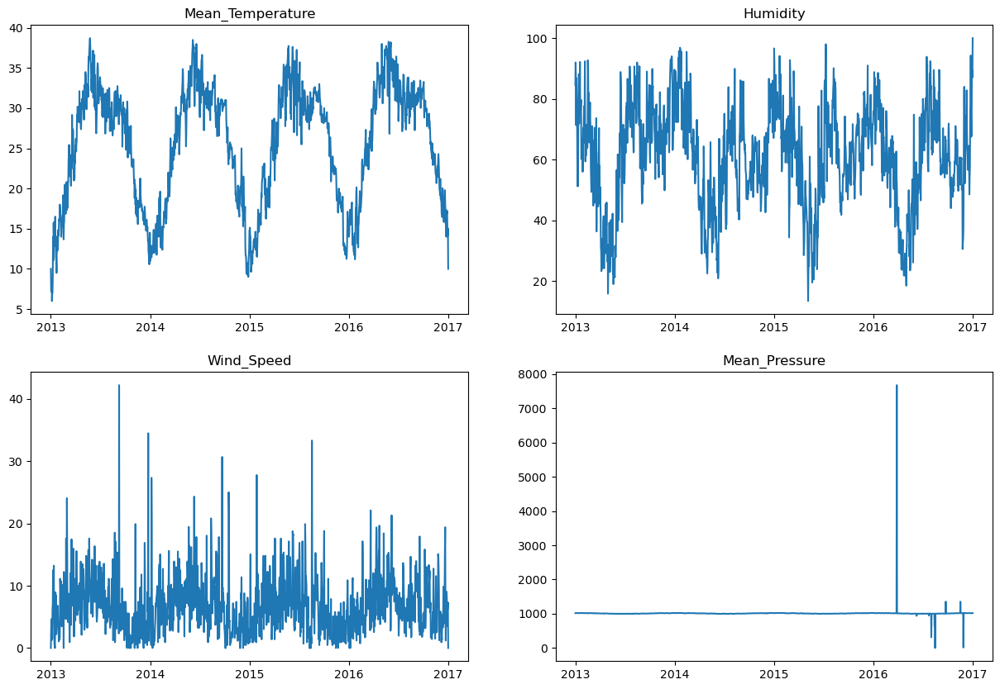

In [4]:
plt.figure(figsize = (15,10))
for i,j in enumerate(weather_data.columns[:-1]):
    ax = plt.subplot(2,2,i+1)
    ax.plot(weather_data[j])
    ax.set(title=j)
    ax.xaxis.set_major_locator(dates.YearLocator())

**Mean_Temperature**

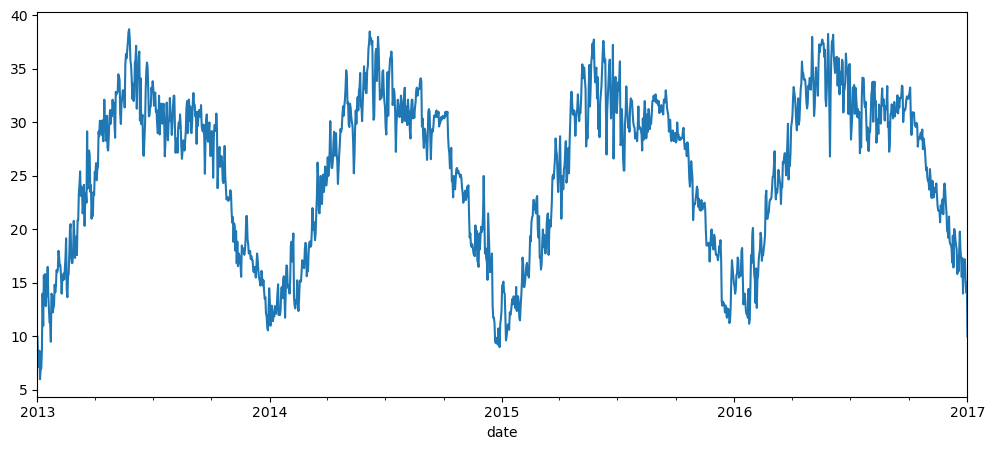

In [5]:
weather_data['Mean_Temperature'].plot(figsize = (12,5));

- The data seems to fluctuate more or less the same way over time, so we can assume that the variance is constant.
- The average seems stable and is somewhere between 20 and 25 but
- **There is seasonality**

Therefore, we cannot say that the data is stationary. Let's check using adfuller and kpss test.

In [6]:
from statsmodels.tsa.stattools import adfuller
def adf(series):
    conclusion = list() ; pvalues=list()
    ALPHA = 0.05
    p_adf=adfuller(series)[1]
    if p_adf > ALPHA: conclusion='Not stationary' 
    if p_adf <= ALPHA: conclusion='Stationary' 
    print('p(adf)    :',p_adf)
    print('Conclusion:',conclusion)

In [7]:
adf(weather_data.Mean_Temperature)

p(adf)    : 0.2774121372301601
Conclusion: Not stationary


In [8]:
from statsmodels.graphics.tsaplots import month_plot
from statsmodels.tsa.seasonal import seasonal_decompose

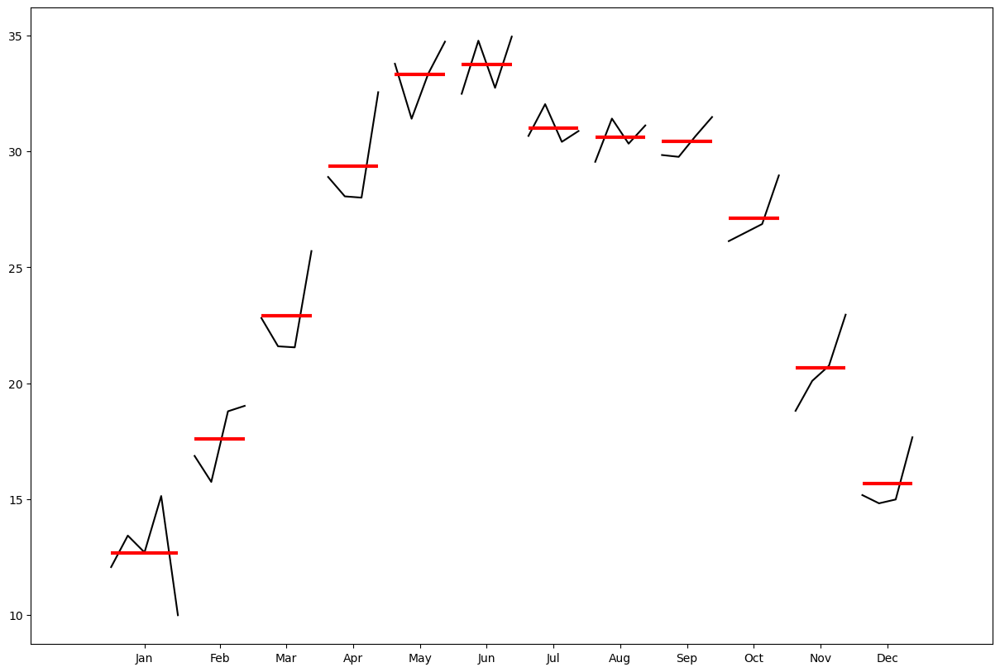

In [9]:
plt.rcParams['figure.figsize'] = 15, 10
month_plot(weather_data.Mean_Temperature.resample(rule = 'M').mean()) 
plt.show()

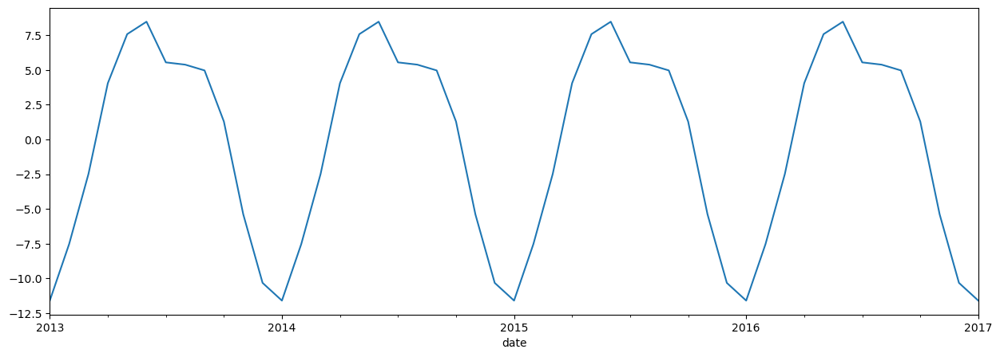

In [10]:
plt.rcParams['figure.figsize'] = 15, 5
seasonal_decompose(weather_data.Mean_Temperature.resample(rule = 'M').mean()).seasonal.plot();
plt.show()

In [11]:
import plotly.graph_objs as go

def show_outliers(feature):
    std = np.nanstd(weather_data[feature])
    mean = np.nanmean(weather_data[feature])

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=weather_data.index, y=weather_data[feature], mode='lines', name=feature, line=dict(color='blue')))
    
    # Mean line
    fig.add_shape(type='line', x0=weather_data.index.min(), x1=weather_data.index.max(), y0=mean, y1=mean, yref='y', xref='x', line=dict(color='red', dash='dash', width=3), name='Avg')

    # 1-sigma lines
    fig.add_shape(type='line', x0=weather_data.index.min(), x1=weather_data.index.max(), y0=mean+1*std, y1=mean+1*std, yref='y', xref='x', line=dict(color='orange', width=2))
    fig.add_shape(type='line', x0=weather_data.index.min(), x1=weather_data.index.max(), y0=mean-1*std, y1=mean-1*std, yref='y', xref='x', line=dict(color='orange', width=2))

    # 3-sigma lines
    fig.add_shape(type='line', x0=weather_data.index.min(), x1=weather_data.index.max(), y0=mean+3*std, y1=mean+3*std, yref='y', xref='x', line=dict(color='black', dash='dot', width=2))
    fig.add_shape(type='line', x0=weather_data.index.min(), x1=weather_data.index.max(), y0=mean-3*std, y1=mean-3*std, yref='y', xref='x', line=dict(color='black', dash='dot', width=2))

    # 6-sigma lines
    fig.add_shape(type='line', x0=weather_data.index.min(), x1=weather_data.index.max(), y0=mean+6*std, y1=mean+6*std, yref='y', xref='x', line=dict(color='purple', dash='dot', width=2))
    fig.add_shape(type='line', x0=weather_data.index.min(), x1=weather_data.index.max(), y0=mean-6*std, y1=mean-6*std, yref='y', xref='x', line=dict(color='purple', dash='dot', width=2))

    # Outliers
    outliers_3sigma = weather_data[(weather_data[feature] > (mean + (3*std))) | (weather_data[feature] < (mean - (3*std)))]
    outliers_6sigma = weather_data[(weather_data[feature] > (mean + (6*std))) | (weather_data[feature] < (mean - (6*std)))]

    fig.add_trace(go.Scatter(x=outliers_3sigma.index, y=outliers_3sigma[feature], mode='markers', marker=dict(color='green', size=10), name='Outlier 3-Sigma'))
    fig.add_trace(go.Scatter(x=outliers_6sigma.index, y=outliers_6sigma[feature], mode='markers', marker=dict(color='red', size=10), name='Outlier 6-Sigma'))

    fig.update_layout(height=600, width=1000, title_text=f'Outliers - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()
    
def find_outliers(arr):
    std = np.nanstd(arr)
    mean = np.nanmean(arr)
    threshold = mean + 6 * std
    anomalies = []
    for i in arr:
        if abs(i)>= threshold:
            anomalies.append(1)
        else:
            anomalies.append(0)
    return anomalies

In [12]:
plt.rcParams['figure.figsize'] = 12, 8
temp_anomalies = find_outliers(weather_data.Mean_Temperature)
show_outliers('Mean_Temperature')

No outliers for the Mean Temperature!

**Humidity**

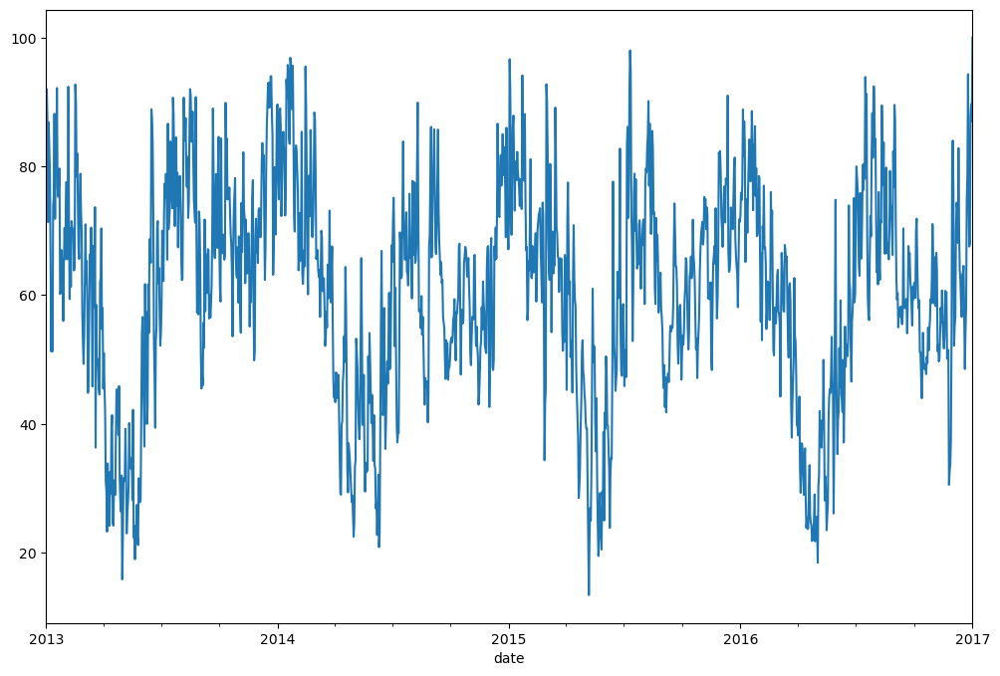

In [13]:
weather_data['Humidity'].plot();

- Mean and variance seem to be constant.
- There seem to be some seasonality but it looks better than the 'Mean Temperature'

This one might be classified as "stationary". Let's check using Dickey Fuller test.

In [14]:
adf(weather_data.Humidity)

p(adf)    : 0.00447010047813071
Conclusion: Stationary


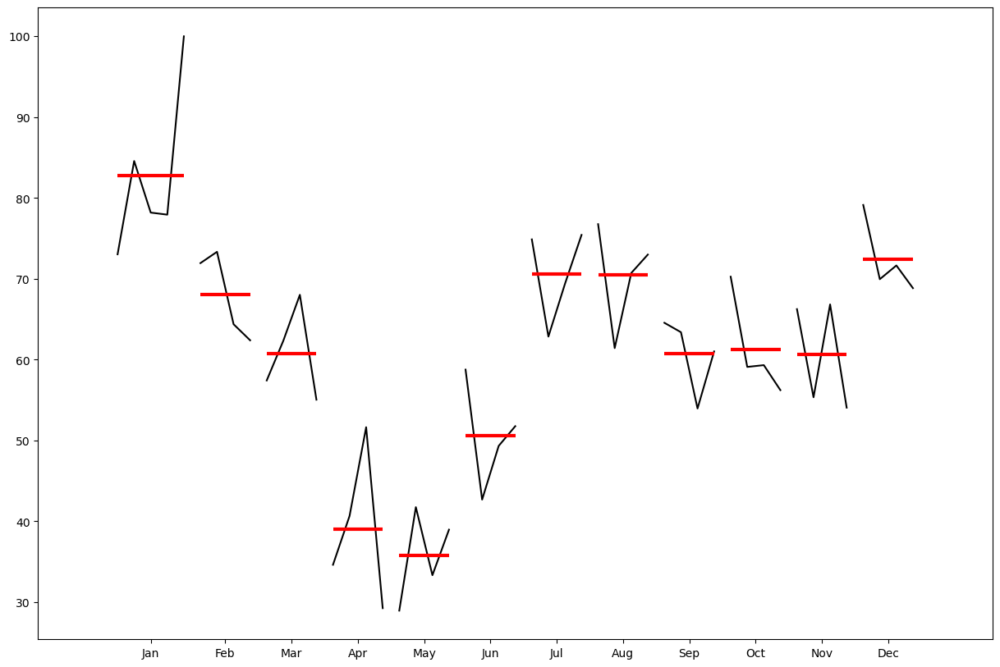

In [15]:
plt.rcParams['figure.figsize'] = 15, 10
month_plot(weather_data.Humidity.resample(rule = 'M').mean()) 
plt.show()

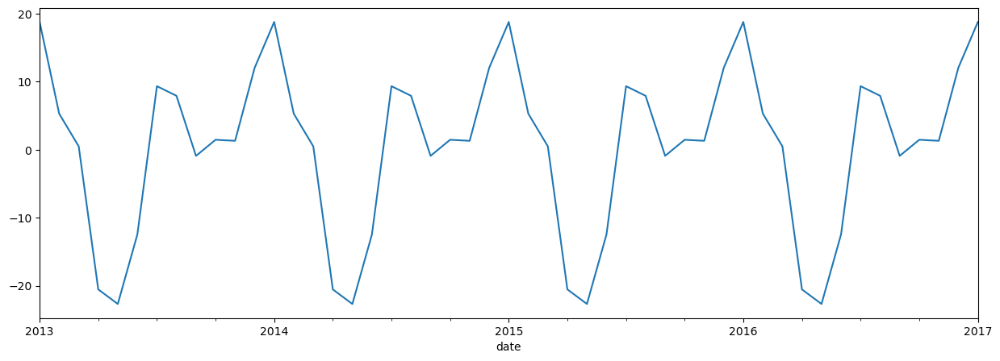

In [16]:
plt.rcParams['figure.figsize'] = 15, 5
seasonal_decompose(weather_data.Humidity.resample(rule = 'M').mean()).seasonal.plot();
plt.show()

In [17]:
plt.rcParams['figure.figsize'] = 12, 8
humidity_anomalies = find_outliers(weather_data.Humidity)
show_outliers('Humidity')

No outliers for humidity either!

**Wind_Speed**

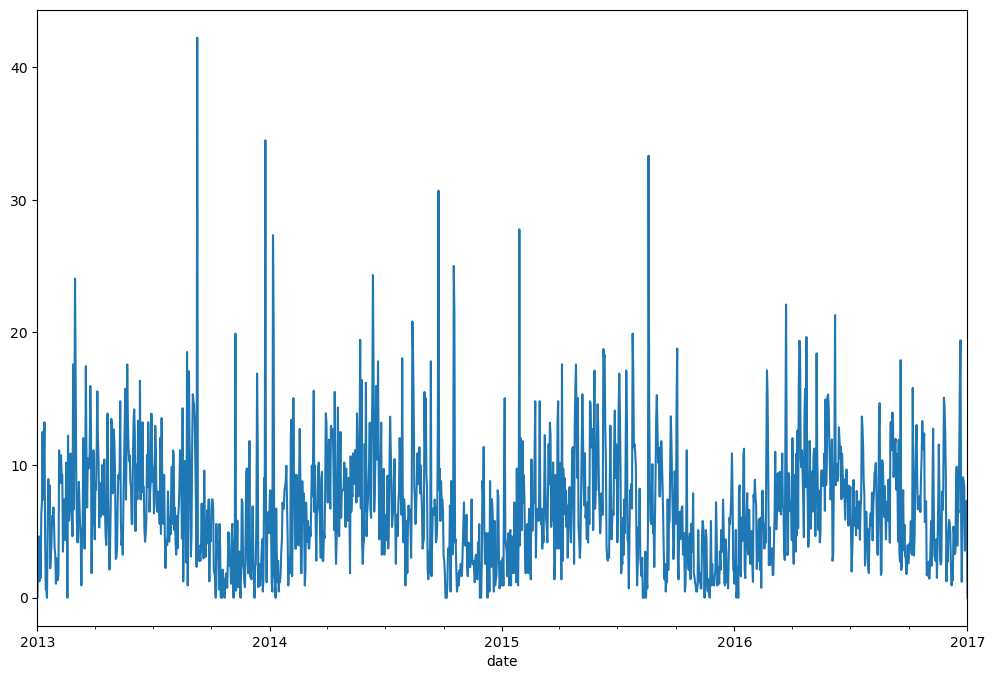

In [18]:
weather_data['Wind_Speed'].plot();

- Mean seems to be constant.
- Variance seems generally constant.
- Seasonality seems even weaker.

Data seems to be stationary. Let's check using Dickey Fuller test.

In [19]:
adf(weather_data.Wind_Speed)

p(adf)    : 0.002540722153146385
Conclusion: Stationary


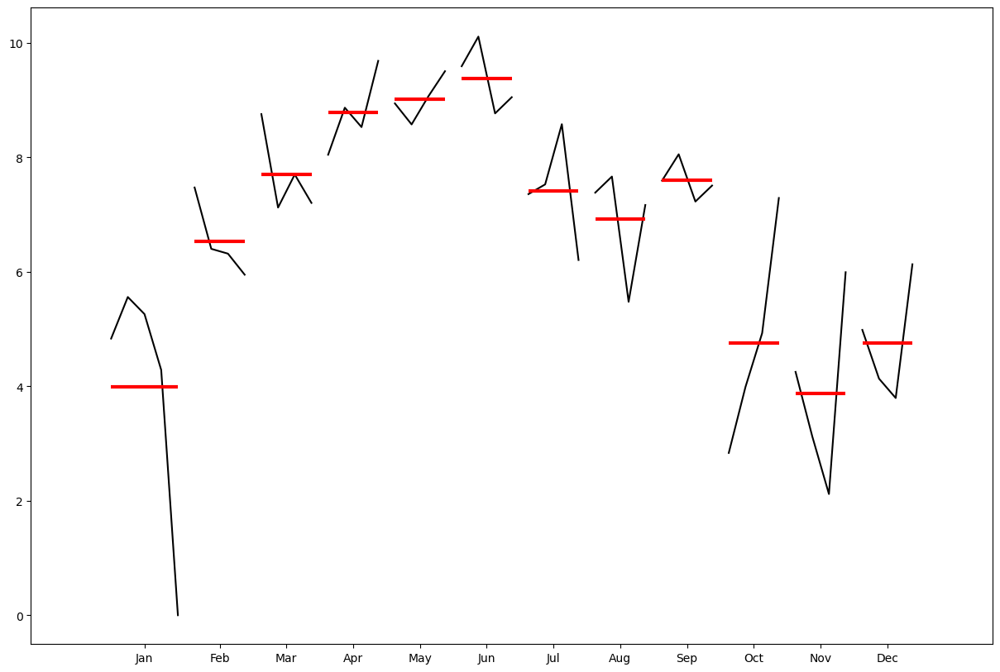

In [20]:
plt.rcParams['figure.figsize'] = 15, 10
month_plot(weather_data.Wind_Speed.resample(rule = 'M').mean()) 
plt.show()

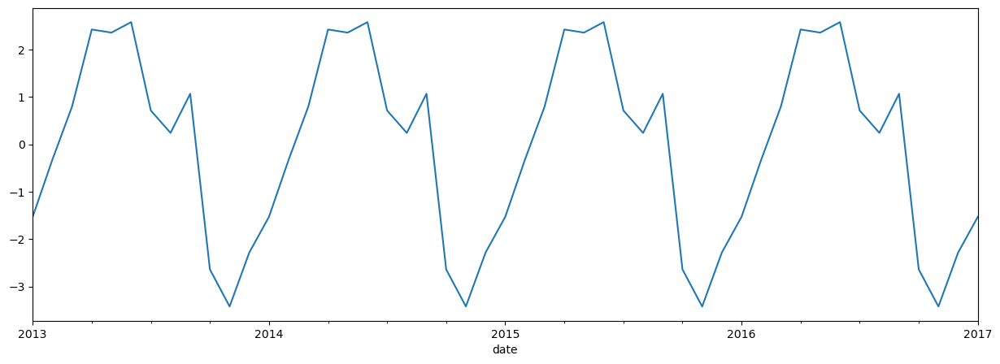

In [21]:
plt.rcParams['figure.figsize'] = 15, 5
seasonal_decompose(weather_data.Wind_Speed.resample(rule = 'M').mean()).seasonal.plot();
plt.show()

In [22]:
plt.rcParams['figure.figsize'] = 12, 8
wind_anomalies = find_outliers(weather_data.Wind_Speed)
show_outliers('Wind_Speed')

There are:

- 12 datapoints 3 standard deviation away from the mean and
- 2 datapoints 6 standard deviation away from the mean.

**Mean_Pressure**

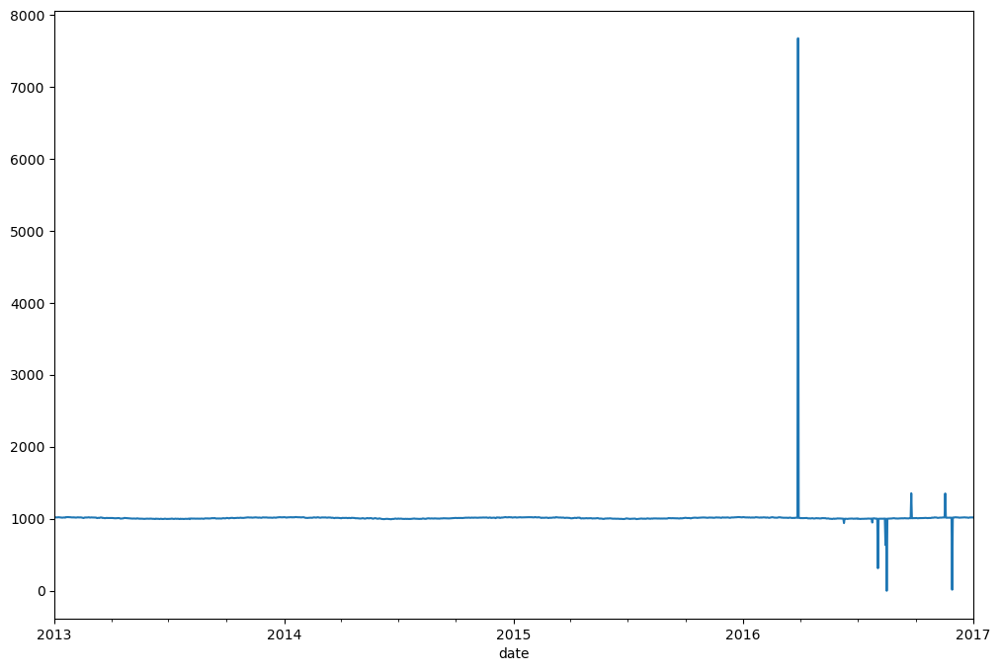

In [23]:
weather_data['Mean_Pressure'].plot();

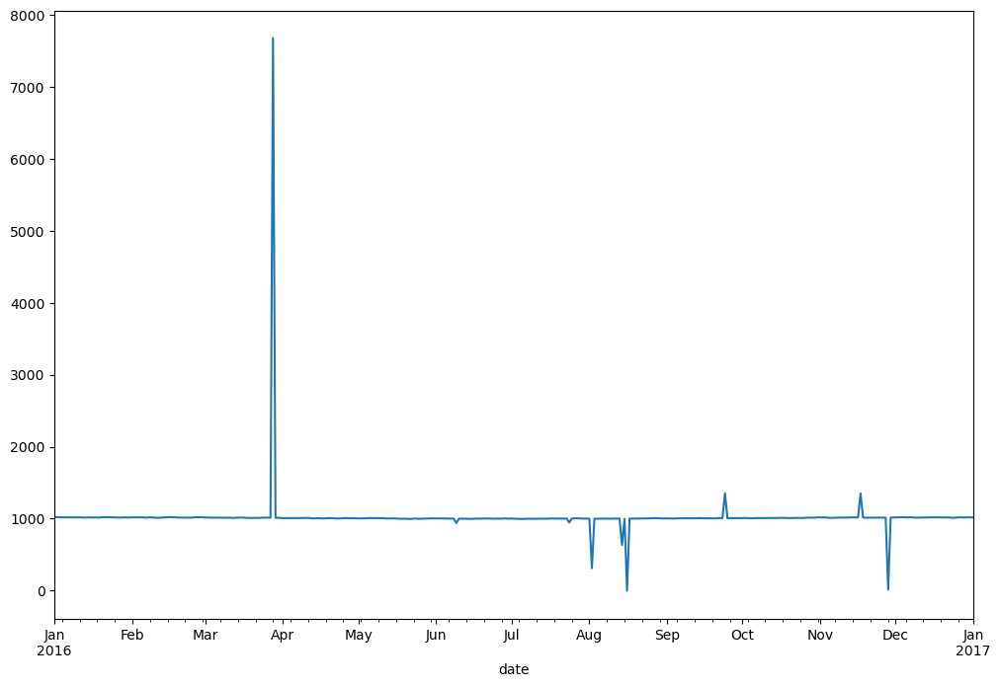

In [24]:
weather_data.loc['2016-01-01':,'Mean_Pressure'].plot();

Data seems to be a flat line with a few outliers.

In [25]:
adf(weather_data.Mean_Pressure)

p(adf)    : 0.0
Conclusion: Stationary


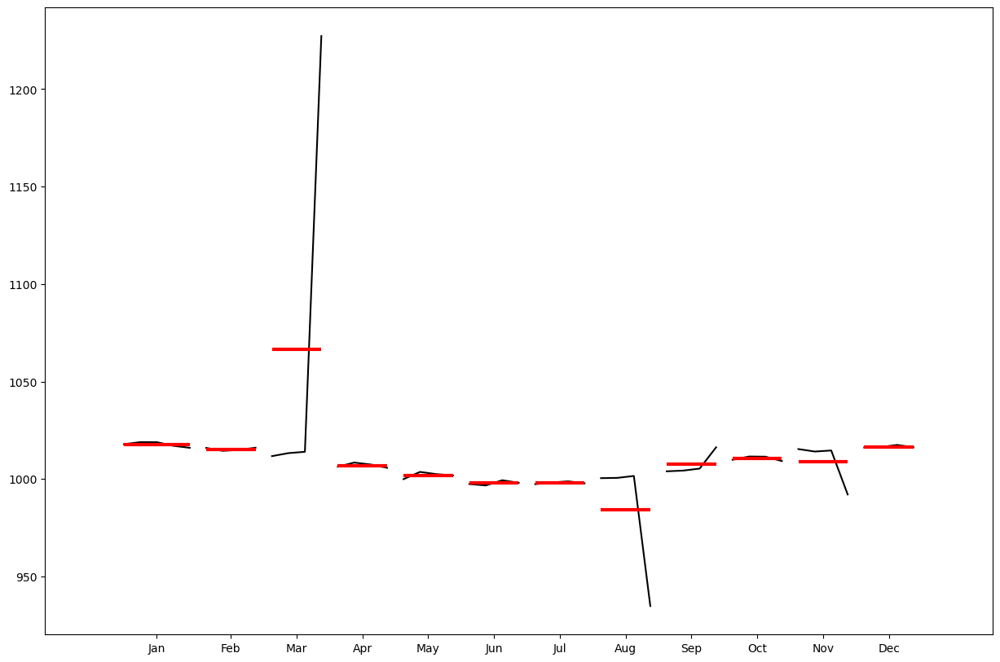

In [26]:
plt.rcParams['figure.figsize'] = 15, 10
month_plot(weather_data.Mean_Pressure.resample(rule = 'M').mean()) 
plt.show()

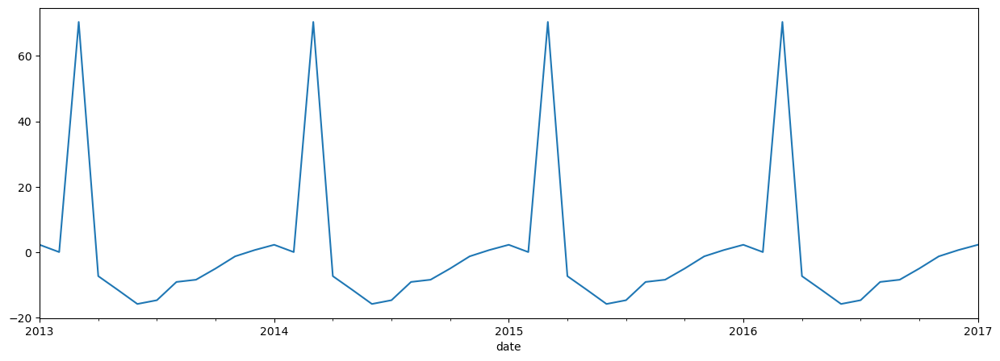

In [27]:
plt.rcParams['figure.figsize'] = 15, 5
seasonal_decompose(weather_data.Mean_Pressure.resample(rule = 'M').mean()).seasonal.plot();
plt.show()

In [28]:
plt.rcParams['figure.figsize'] = 12, 8
pressure_anomalies = find_outliers(weather_data.Mean_Pressure)
show_outliers('Mean_Pressure')

There are:

- 3 datapoints 3 standard deviation away from the mean and
- 1 datapoint 6 standard deviation away from the mean.

Let's add some time features to the data

In [29]:
timeFeatures = pd.DataFrame()

timeFeatures['year'] = weather_data.index.year
timeFeatures['month'] = weather_data.index.month
timeFeatures['week'] = weather_data.index.week
timeFeatures['day'] = weather_data.index.day

Sin and Cos waves

In [30]:
def cycle_encode(data, cols):
    for col in cols:
        data[col + '_sin'] = np.sin(2 * np.pi * data[col]/data[col].max())
        data[col + '_cos'] = np.cos(2 * np.pi * data[col]/data[col].max())
    return data

In [31]:
cycle_encode(timeFeatures,['month', 'week', 'day'])
timeFeatures.head()

,year,month,week,day,month_sin,month_cos,week_sin,week_cos,day_sin,day_cos
0,2013,1,1,1,0.5,0.866025,0.118273,0.992981,0.201299,0.979530
1,2013,1,1,2,0.5,0.866025,0.118273,0.992981,0.394356,0.918958
2,2013,1,1,3,0.5,0.866025,0.118273,0.992981,0.571268,0.820763
3,2013,1,1,4,0.5,0.866025,0.118273,0.992981,0.724793,0.688967
4,2013,1,1,5,0.5,0.866025,0.118273,0.992981,0.848644,0.528964


<Axes: >

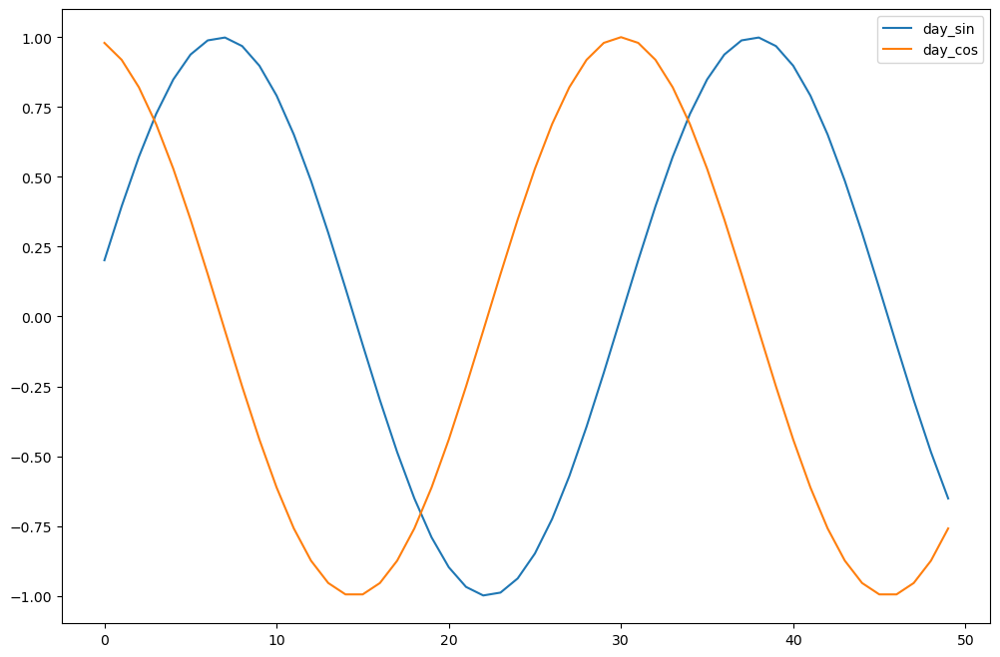

In [32]:
timeFeatures[['day_sin','day_cos']][:50].plot()

## Anomaly Detection Using 6-Sigma

In [33]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

estimators = weather_data.drop('Anomaly', axis = 1)
target = weather_data['Anomaly']

idx = weather_data[weather_data['Anomaly'] == 1].index
features = weather_data.columns[:-1]
metrics = ['True Positive', 'False Positive', 'False Negative']

In [34]:
sixSigmaAnomalies = []
for i in range(len(weather_data)):
    if (temp_anomalies[i] == 1) or (humidity_anomalies[i] == 1) or (wind_anomalies[i] == 1) or (pressure_anomalies[i] == 1):
        sixSigmaAnomalies.append(1)
    else:
        sixSigmaAnomalies.append(0)

sixSigmaDF = pd.DataFrame(data = sixSigmaAnomalies, index = weather_data.index, columns = ['Anomalies'])

sixSigmaDF_idx = sixSigmaDF[sixSigmaDF['Anomalies'] == 1].index

TP = []
FP = []
FN = []

for i in sixSigmaDF_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in sixSigmaDF_idx:
        FN.append(str(i))

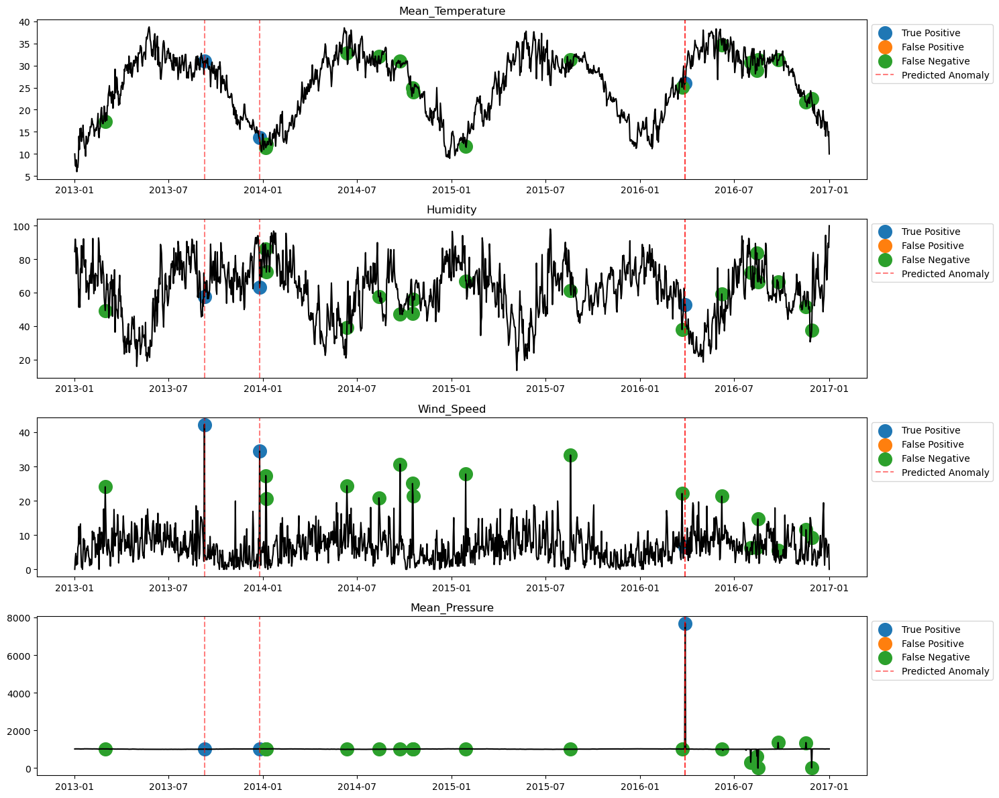

In [35]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in sixSigmaDF_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [36]:
from plotly.subplots import make_subplots

In [37]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in sixSigmaDF_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with 6-Sigma - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

In [38]:
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score, recall_score, roc_auc_score, precision_recall_curve
from sklearn.metrics import f1_score, fbeta_score, make_scorer, accuracy_score, average_precision_score
from sklearn.metrics import roc_curve, auc

def print_results(headline, true_value, pred):
    scores=[]
    CM = confusion_matrix(true_value, pred)
    scores.append(headline)
    scores.append(accuracy_score(true_value, pred))      #accuracy
    scores.append(int(CM[1,1]))                          #TP
    scores.append(int(CM[0,1]))                          #FP
    scores.append(int(CM[0][0]))                         #TN
    scores.append(int(CM[1][0]))                         #FN
    scores.append(precision_score(true_value, pred))     #precision
    scores.append(recall_score(true_value, pred))        #recall
    scores.append(roc_auc_score(true_value, pred))      #roc_auc
    p, r, _ = precision_recall_curve(true_value, pred) 
    scores.append(auc(r,p))                              #pr_auc
    scores.append(f1_score(true_value, pred))            #f1-score
    scores.append(fbeta_score(true_value, pred, beta=2)) #f2-score
    return scores

score_names = ['method','accuracy','TP','FP','TN','FN','precision','recall','roc_auc','pr_auc','f1', 'f2']
dfAcc = pd.DataFrame(data=np.zeros(shape=(0,12)), columns = score_names)

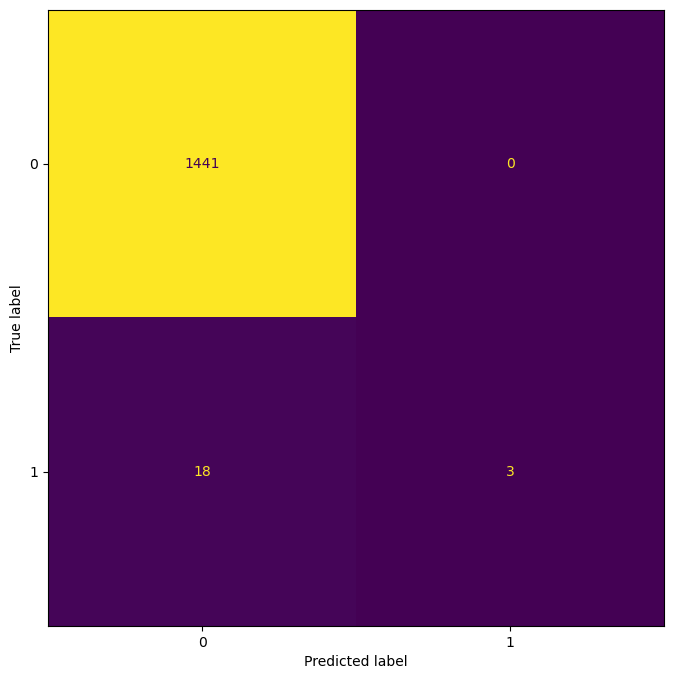

In [39]:
plt.rcParams
ConfusionMatrixDisplay.from_predictions(target, sixSigmaDF['Anomalies'], colorbar=False)
plt.grid(False)

In [40]:
scores = print_results('6-Sigma', target, sixSigmaDF['Anomalies'])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414


Adding time fetures to the data

In [41]:
for i in timeFeatures.columns:
    estimators[i] = np.array(timeFeatures[i])
estimators.head()

,Mean_Temperature,Humidity,Wind_Speed,Mean_Pressure,year,month,week,day,month_sin,month_cos,week_sin,week_cos,day_sin,day_cos
date,,,,,,,,,,,,,,
2013-01-01,10.000000,84.500000,0.000000,1015.666667,2013,1,1,1,0.5,0.866025,0.118273,0.992981,0.201299,0.979530
2013-01-02,7.400000,92.000000,2.980000,1017.800000,2013,1,1,2,0.5,0.866025,0.118273,0.992981,0.394356,0.918958
2013-01-03,7.166667,87.000000,4.633333,1018.666667,2013,1,1,3,0.5,0.866025,0.118273,0.992981,0.571268,0.820763
2013-01-04,8.666667,71.333333,1.233333,1017.166667,2013,1,1,4,0.5,0.866025,0.118273,0.992981,0.724793,0.688967
2013-01-05,6.000000,86.833333,3.700000,1016.500000,2013,1,1,5,0.5,0.866025,0.118273,0.992981,0.848644,0.528964


## Anomaly Detection Using IsolationForest

In [42]:
from sklearn.ensemble import IsolationForest

In [43]:
time_dict = {}

isolation_forest = IsolationForest(contamination=0.05)

start_time = time.time()
isolation_forest.fit(estimators)
end_time = time.time()
IsolationForest005_time=end_time-start_time
time_dict['IsolationForest005_time'] = IsolationForest005_time

anomaly_predictions = isolation_forest.predict(estimators)

# Get the indices of the anomalies
anomalies_IsolationForest = pd.DataFrame(data = np.where(anomaly_predictions == -1, 1, 0), index=weather_data.index)

anomalies_IsolationForest_idx = anomalies_IsolationForest[anomalies_IsolationForest[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_IsolationForest_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_IsolationForest_idx:
        FN.append(str(i))

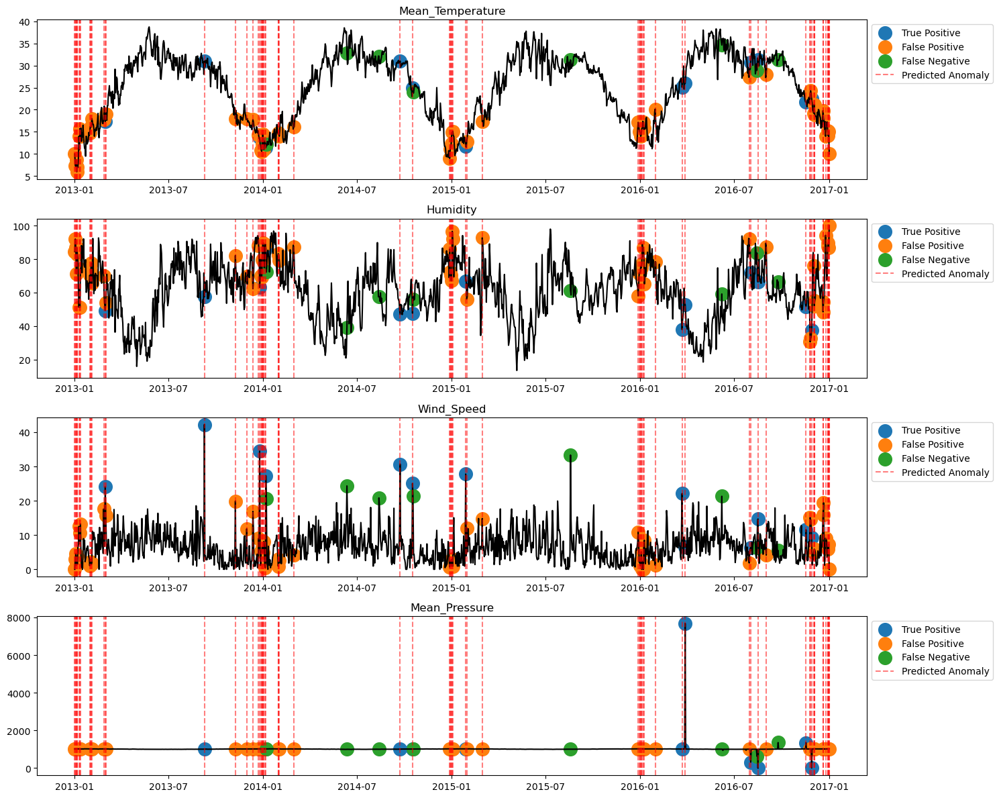

In [44]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_IsolationForest_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [45]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_IsolationForest_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with IsolationForest - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

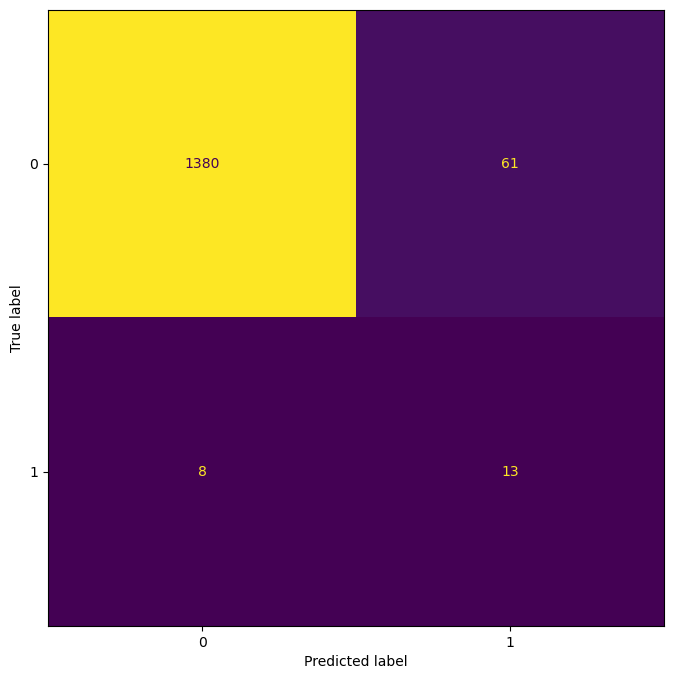

In [46]:
plt.rcParams
ConfusionMatrixDisplay.from_predictions(target, anomalies_IsolationForest[0], colorbar=False)

In [47]:
scores = print_results('IsolationForest_0.05', target, anomalies_IsolationForest[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392


In [48]:
isolation_forest = IsolationForest(contamination=0.01)

start_time = time.time()
isolation_forest.fit(estimators)
end_time = time.time()
IsolationForest001_time=end_time-start_time
time_dict['IsolationForest001_time'] = IsolationForest001_time

# Predict anomalies
anomaly_predictions = isolation_forest.predict(estimators)

# Get the indices of the anomalies
anomalies_IsolationForest = pd.DataFrame(data = np.where(anomaly_predictions == -1, 1, 0), index=weather_data.index)

anomalies_IsolationForest_idx = anomalies_IsolationForest[anomalies_IsolationForest[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_IsolationForest_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_IsolationForest_idx:
        FN.append(str(i))

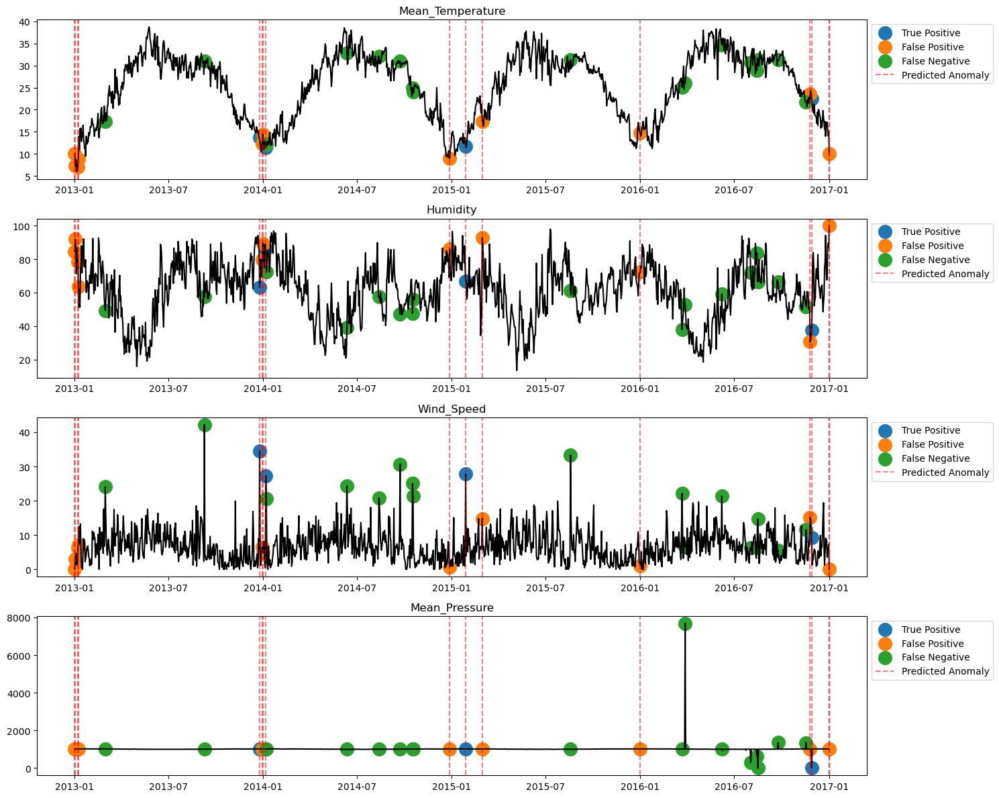

In [49]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_IsolationForest_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [50]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_IsolationForest_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with IsolationForest - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

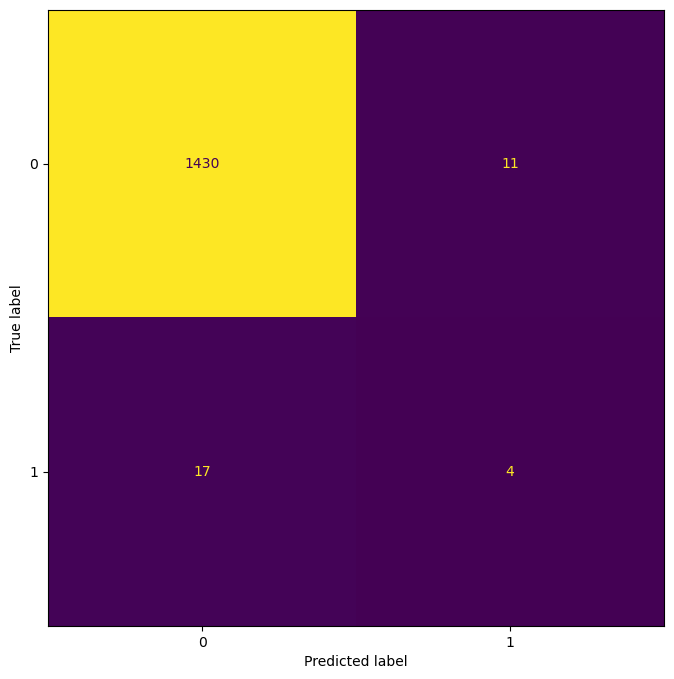

In [51]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_IsolationForest[0], colorbar=False)

In [52]:
scores = print_results('IsolationForest_0.01', target, anomalies_IsolationForest[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020


## Anomaly Detection Using KMeans

In [53]:
from sklearn.cluster import KMeans
from scipy.spatial import distance

In [54]:
n_clusters = 5

kmeans_pipeline = Pipeline([
    ('scaling', StandardScaler()),
    ('kmeans', KMeans(n_clusters=n_clusters))
])

start_time = time.time()
kmeans_pipeline.fit(estimators)
end_time = time.time()
KMeans05_time=end_time-start_time
time_dict['KMeans05_time'] = KMeans05_time

scaler_pipeline = Pipeline([('scaling', StandardScaler())])

weather_data_scaled = scaler_pipeline.fit_transform(estimators)

closest_centroid = kmeans_pipeline.named_steps['kmeans'].cluster_centers_[kmeans_pipeline.named_steps['kmeans'].labels_]

distances = np.linalg.norm(weather_data_scaled - closest_centroid, axis=1)

threshold = np.percentile(distances, 95)

anomalies_indices = np.where(distances > threshold)[0]

anomalies_KMeans = pd.DataFrame(data = np.where(distances > threshold, 1, 0), index=weather_data.index)

anomalies_KMeans_idx = anomalies_IsolationForest[anomalies_IsolationForest[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_KMeans_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_KMeans_idx:
        FN.append(str(i))

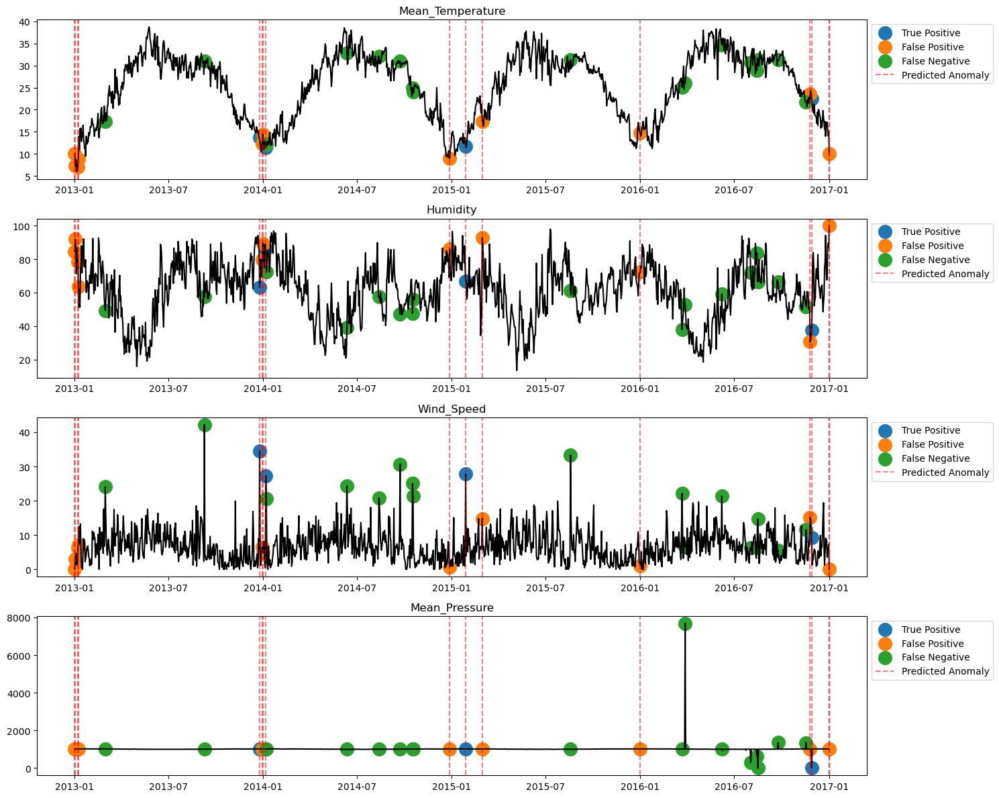

In [55]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_KMeans_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [56]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_KMeans_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with KMeans - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

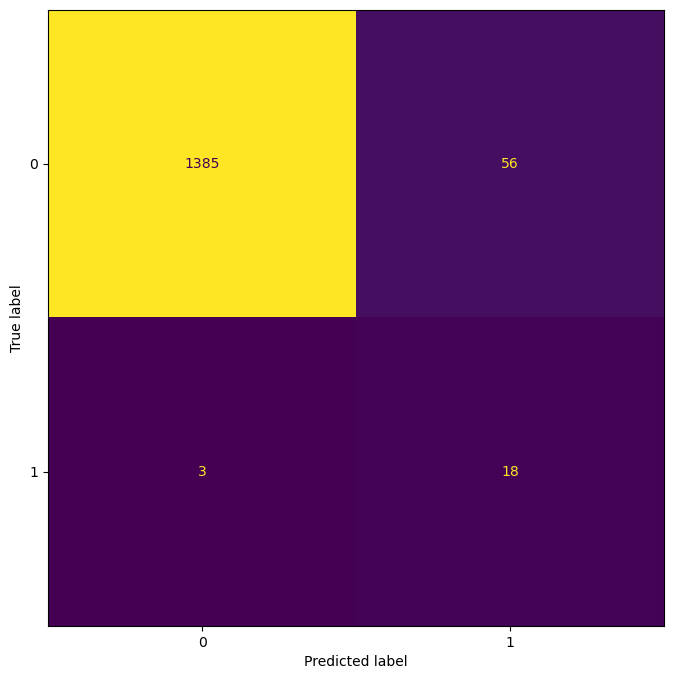

In [57]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_KMeans[0], colorbar=False)

In [58]:
scores = print_results('KMeans_Cluster_5', target, anomalies_KMeans[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620


In [59]:
n_clusters = 10

kmeans_pipeline = Pipeline([
    ('scaling', StandardScaler()),
    ('kmeans', KMeans(n_clusters=n_clusters))
])

start_time = time.time()
kmeans_pipeline.fit(estimators)
end_time = time.time()
KMeans10_time=end_time-start_time
time_dict['KMeans10_time'] = KMeans10_time

closest_centroid = kmeans_pipeline.named_steps['kmeans'].cluster_centers_[kmeans_pipeline.named_steps['kmeans'].labels_]

distances = np.linalg.norm(weather_data_scaled - closest_centroid, axis=1)

threshold = np.percentile(distances, 95)

anomalies_indices = np.where(distances > threshold)[0]

anomalies_KMeans = pd.DataFrame(data = np.where(distances > threshold, 1, 0), index=weather_data.index)

anomalies_KMeans_idx = anomalies_IsolationForest[anomalies_IsolationForest[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_KMeans_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_KMeans_idx:
        FN.append(str(i))

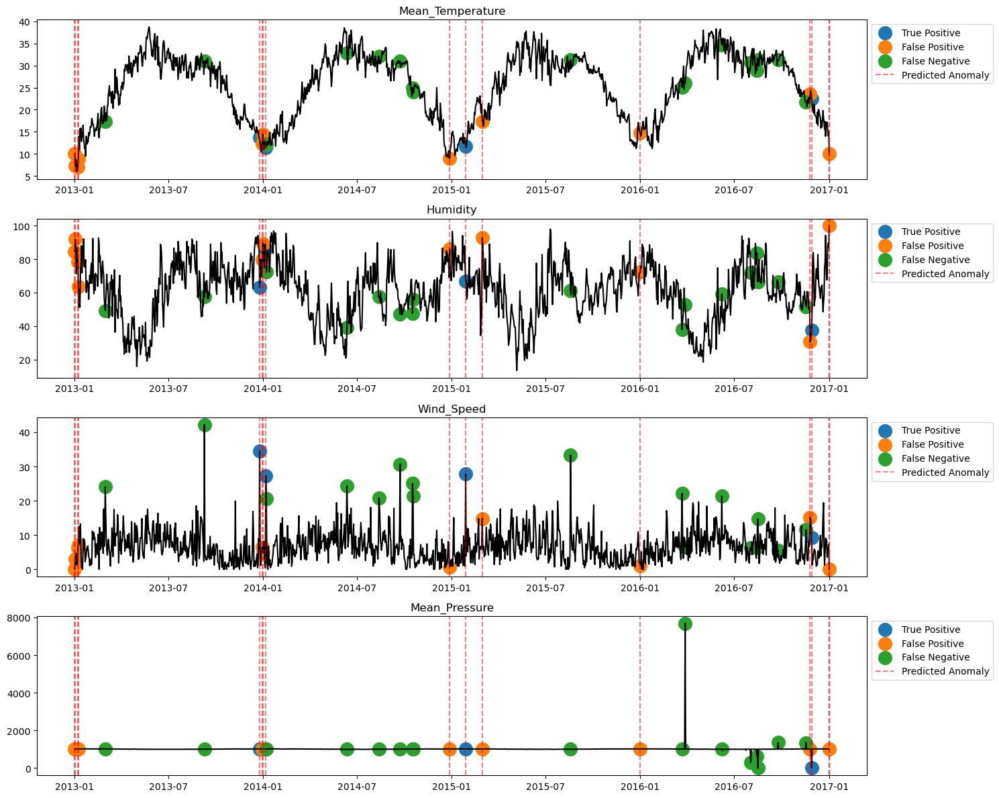

In [60]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_KMeans_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [61]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_KMeans_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with KMeans - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

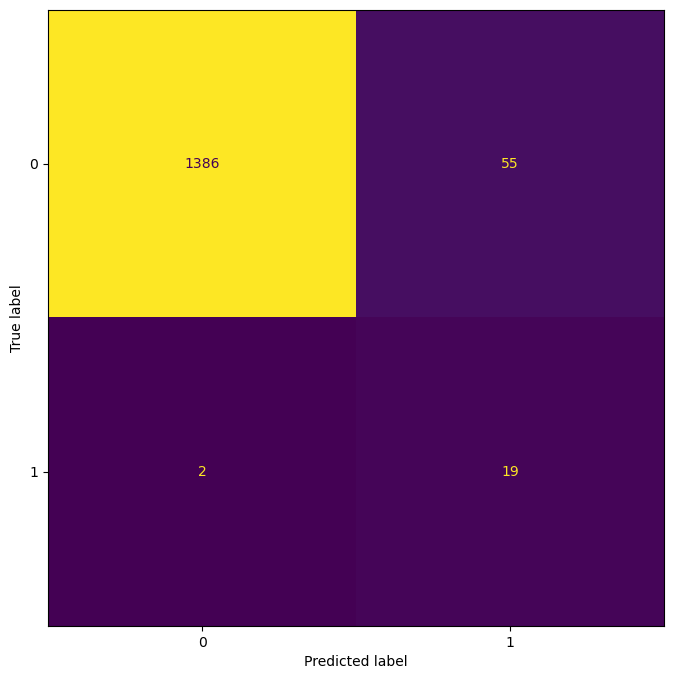

In [62]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_KMeans[0], colorbar=False)

In [63]:
scores = print_results('KMeans_Cluster_10', target, anomalies_KMeans[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266


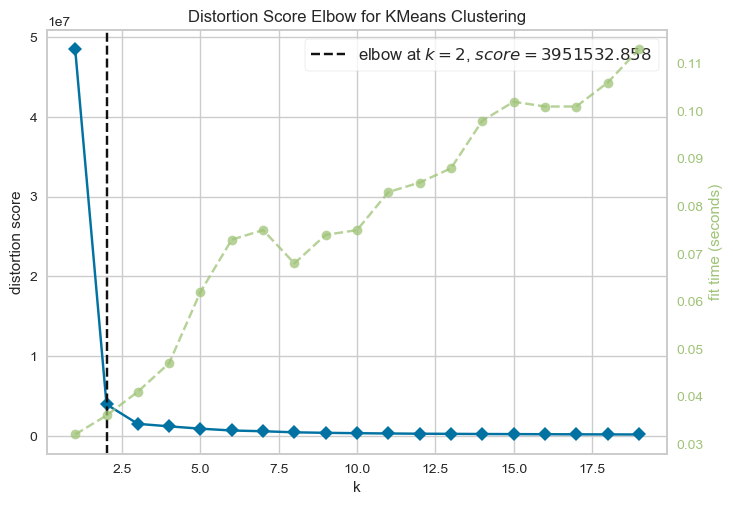

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [64]:
from yellowbrick.cluster import KElbowVisualizer
kmodel = KMeans(random_state=42)
viz = KElbowVisualizer(kmodel,k=(1,20))
viz.fit(estimators)
viz.poof()

In [65]:
n_clusters = 2

kmeans_pipeline = Pipeline([
    ('scaling', StandardScaler()),
    ('kmeans', KMeans(n_clusters=n_clusters))
])

start_time = time.time()
kmeans_pipeline.fit(estimators)
end_time = time.time()
KMeans02_time=end_time-start_time
time_dict['KMeans02_time'] = KMeans02_time

closest_centroid = kmeans_pipeline.named_steps['kmeans'].cluster_centers_[kmeans_pipeline.named_steps['kmeans'].labels_]

distances = np.linalg.norm(weather_data_scaled - closest_centroid, axis=1)

threshold = np.percentile(distances, 95)

anomalies_indices = np.where(distances > threshold)[0]

anomalies_KMeans = pd.DataFrame(data = np.where(distances > threshold, 1, 0), index=weather_data.index)

anomalies_KMeans_idx = anomalies_IsolationForest[anomalies_IsolationForest[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_KMeans_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_KMeans_idx:
        FN.append(str(i))

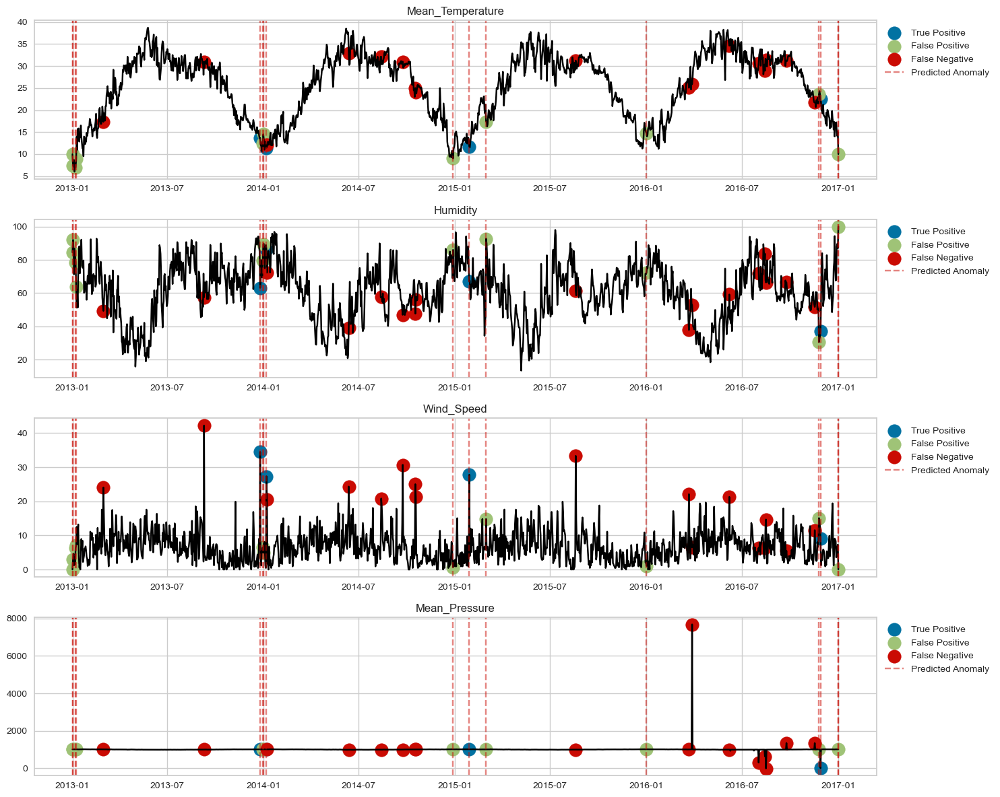

In [66]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_KMeans_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [67]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_KMeans_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with KMeans - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

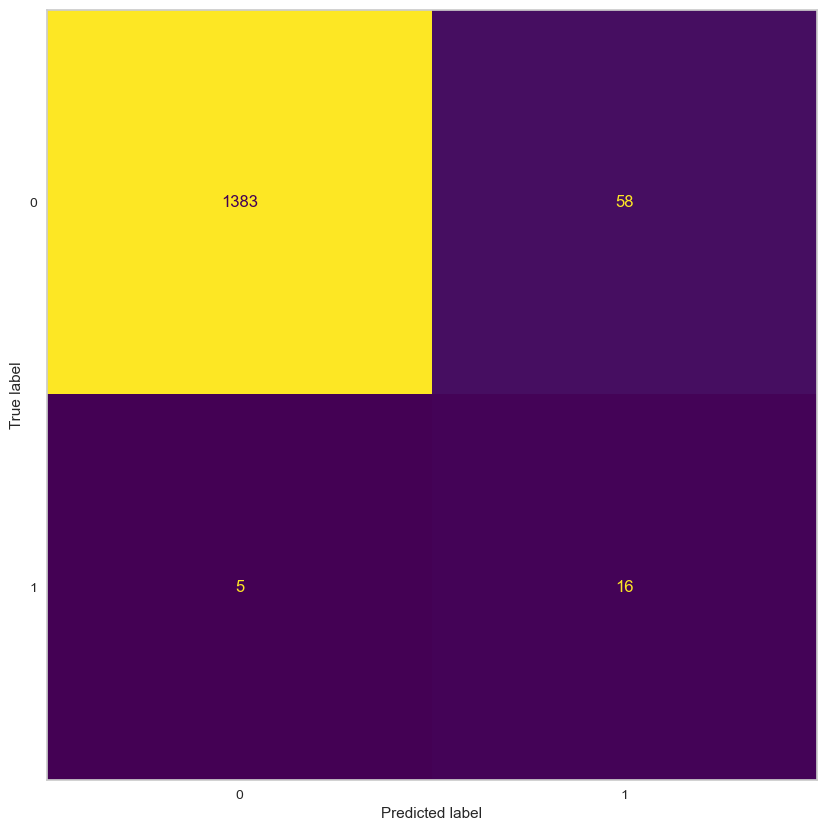

In [68]:
plt.rcParams['figure.figsize'] = 15, 10
ConfusionMatrixDisplay.from_predictions(target, anomalies_KMeans[0], colorbar=False)
plt.grid(False)

In [69]:
scores = print_results('KMeans_Cluster_2', target, anomalies_KMeans[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266
KMeans_Cluster_2,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329


## Anomaly Detection Using GaussianMixture

In [70]:
from sklearn.mixture import GaussianMixture

In [71]:
n_components = 3

gaus_pipeline = Pipeline([
    ('scaling', StandardScaler()),
    ('gaus', GaussianMixture(n_components=n_components))
])

start_time = time.time()
gaus_pipeline.fit(estimators)
end_time = time.time()
GaussianMixture03_time=end_time-start_time
time_dict['GaussianMixture03_time'] = GaussianMixture03_time

weather_data_scaled = gaus_pipeline.named_steps['scaling'].transform(estimators)
log_likelihoods = gaus_pipeline.named_steps['gaus'].score_samples(weather_data_scaled)

threshold = np.percentile(log_likelihoods, 5) 

anomalies_indices = np.where(log_likelihoods < threshold)[0]

anomalies_GaussianMixture = pd.DataFrame(data = np.where(log_likelihoods < threshold, 1, 0), index=weather_data.index)

anomalies_GaussianMixture_idx = anomalies_GaussianMixture[anomalies_GaussianMixture[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_GaussianMixture_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_GaussianMixture_idx:
        FN.append(str(i))

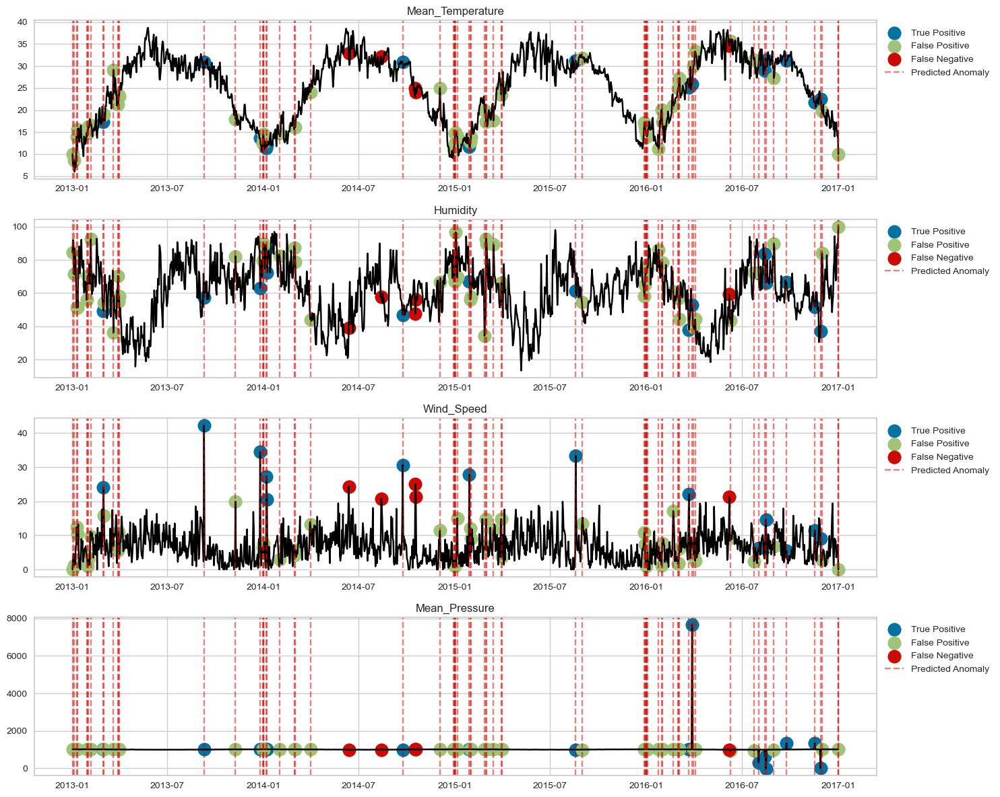

In [72]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_GaussianMixture_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [73]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_GaussianMixture_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with GaussianMixture - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

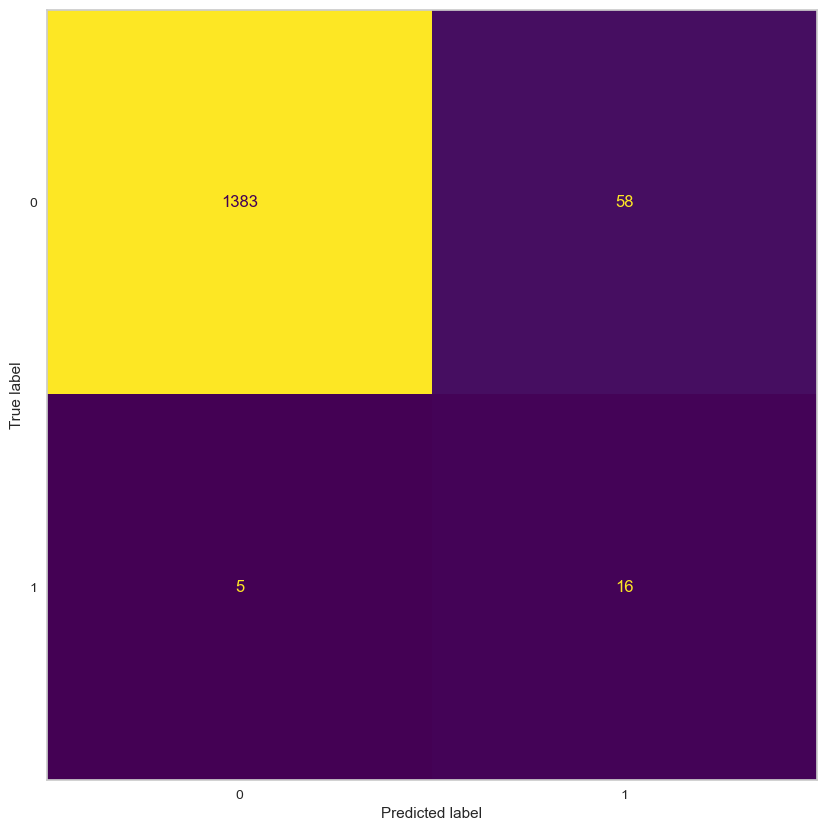

In [74]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_GaussianMixture[0], colorbar=False)
plt.grid(False)

In [75]:
scores = print_results('GaussianMixture_5', target, anomalies_GaussianMixture[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266
KMeans_Cluster_2,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_5,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329


In [76]:
threshold = np.percentile(log_likelihoods, 1) 

anomalies_indices = np.where(log_likelihoods < threshold)[0]

anomalies_GaussianMixture = pd.DataFrame(data = np.where(log_likelihoods < threshold, 1, 0), index=weather_data.index)

anomalies_GaussianMixture_idx = anomalies_GaussianMixture[anomalies_GaussianMixture[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_GaussianMixture_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_GaussianMixture_idx:
        FN.append(str(i))

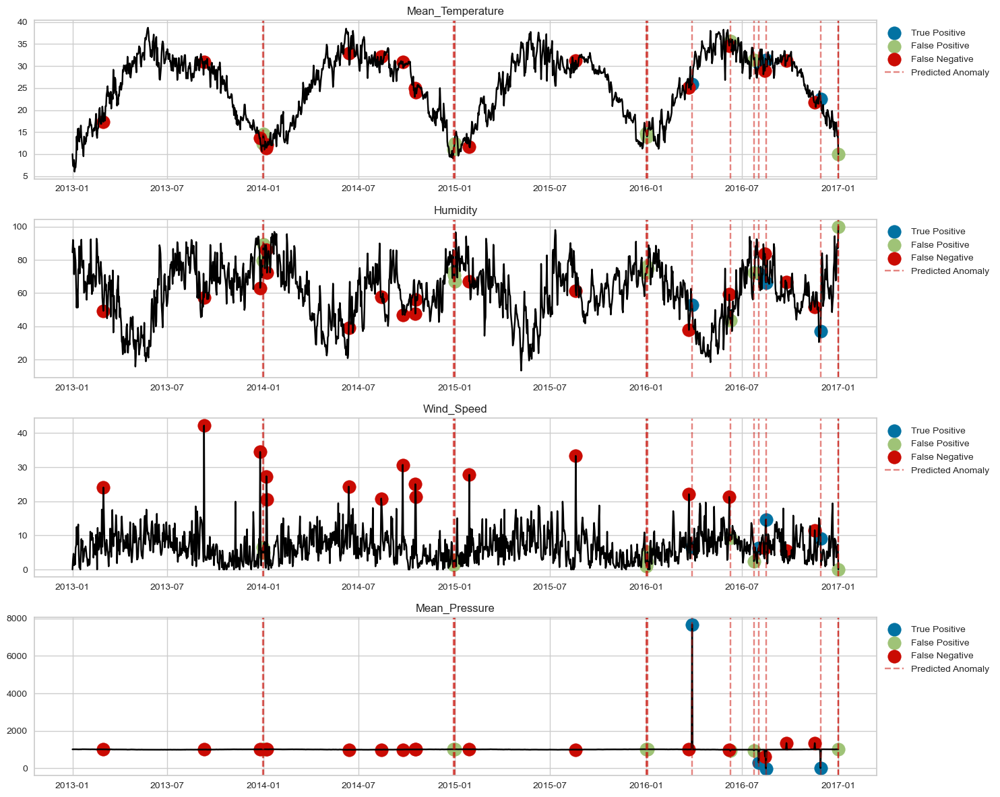

In [77]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_GaussianMixture_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [78]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_GaussianMixture_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with GaussianMixture - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

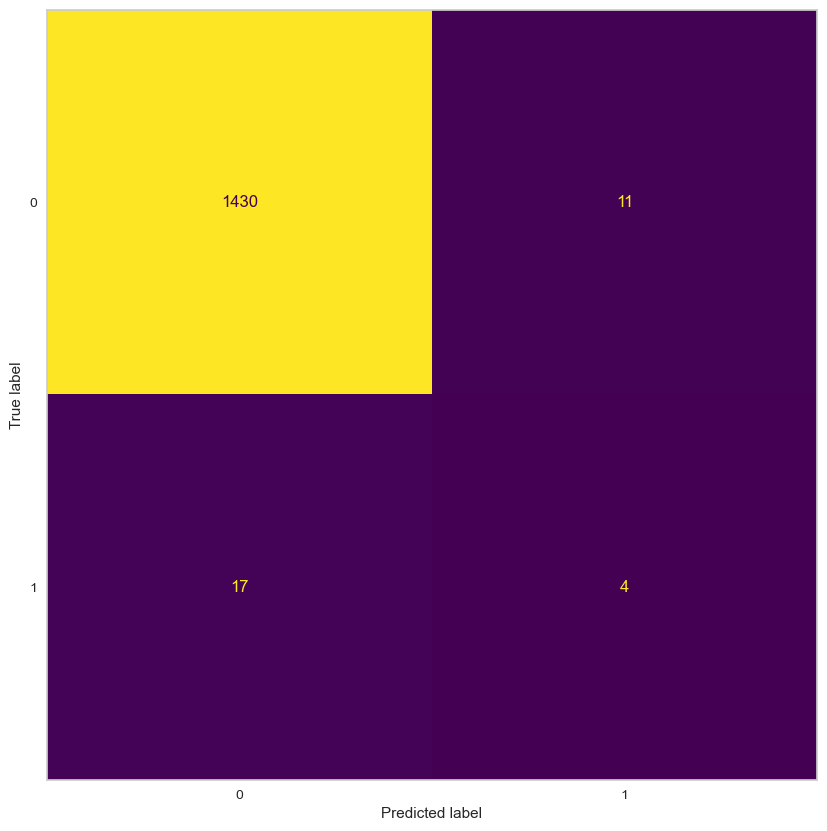

In [79]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_GaussianMixture[0], colorbar=False)
plt.grid(False)

In [80]:
scores = print_results('GaussianMixture_1', target, anomalies_GaussianMixture[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266
KMeans_Cluster_2,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_5,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_1,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020


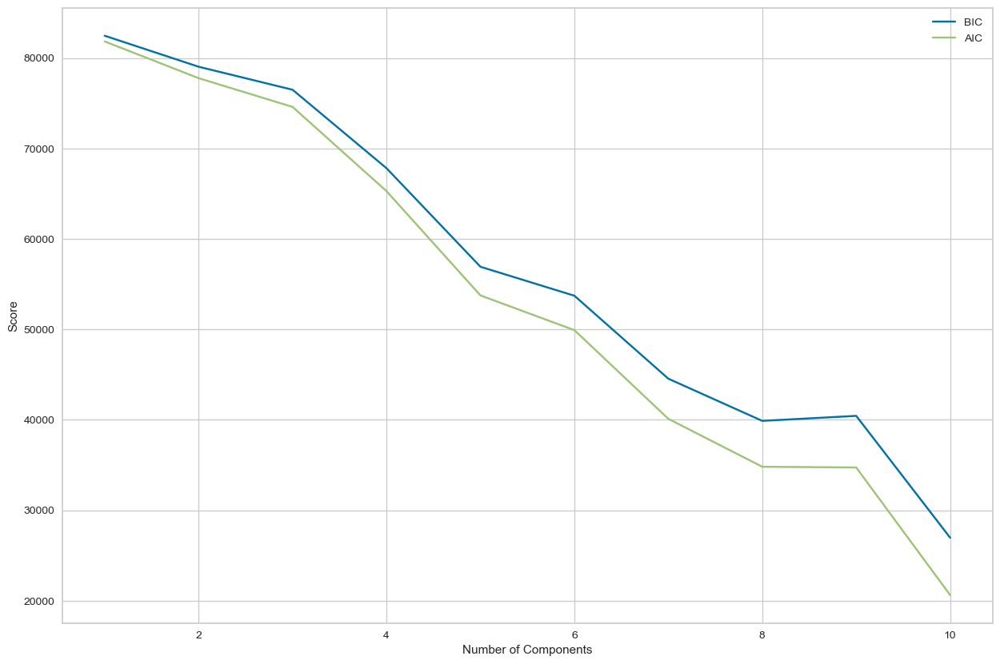

In [81]:
N = np.arange(1,11)
models = [GaussianMixture(n,covariance_type='full', random_state=42).fit(estimators) for n in N]
plt.plot(N, [m.bic(estimators) for m in models], label='BIC')
plt.plot(N, [m.aic(estimators) for m in models], label='AIC')
plt.legend()
plt.xlabel('Number of Components')
plt.ylabel('Score');

In [82]:
n_components = 8

gaus_pipeline = Pipeline([
    ('scaling', StandardScaler()),
    ('gaus', GaussianMixture(n_components=n_components))
])

start_time = time.time()
gaus_pipeline.fit(estimators)
end_time = time.time()
GaussianMixture08_time=end_time-start_time
time_dict['GaussianMixture08_time'] = GaussianMixture08_time

weather_data_scaled = gaus_pipeline.named_steps['scaling'].transform(estimators)
log_likelihoods = gaus_pipeline.named_steps['gaus'].score_samples(weather_data_scaled)

threshold = np.percentile(log_likelihoods, 5) 

anomalies_indices = np.where(log_likelihoods < threshold)[0]

anomalies_GaussianMixture = pd.DataFrame(data = np.where(log_likelihoods < threshold, 1, 0), index=weather_data.index)

anomalies_GaussianMixture_idx = anomalies_GaussianMixture[anomalies_GaussianMixture[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_GaussianMixture_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_GaussianMixture_idx:
        FN.append(str(i))

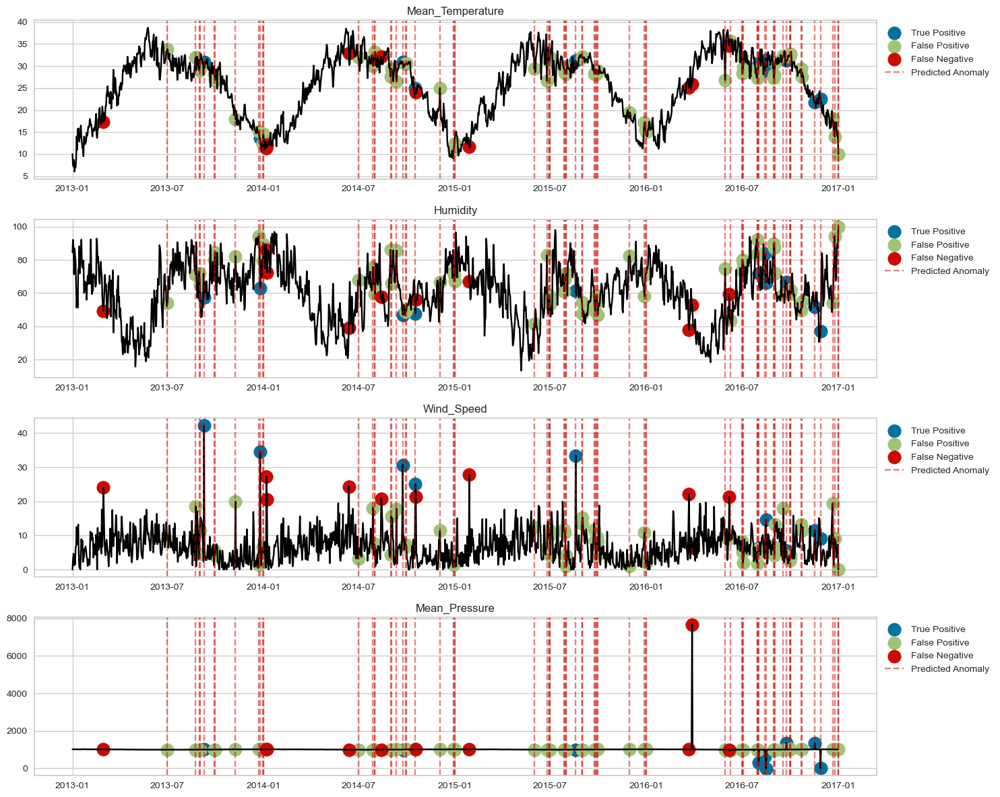

In [83]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_GaussianMixture_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [84]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_GaussianMixture_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with GaussianMixture - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

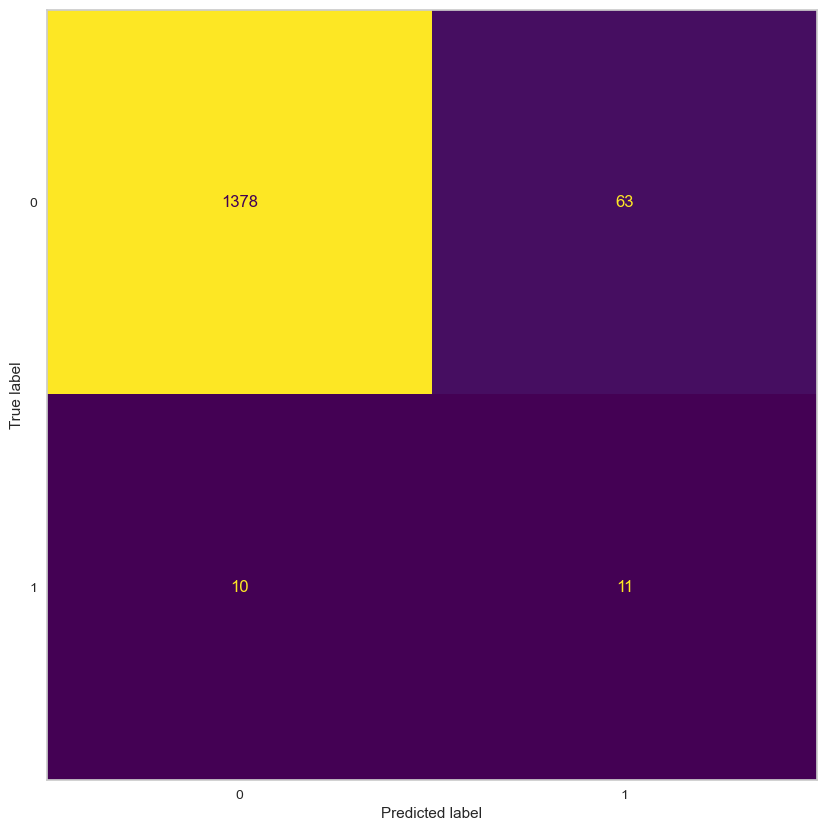

In [85]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_GaussianMixture[0], colorbar=False)
plt.grid(False)

In [86]:
scores = print_results('GaussianMixture_4', target, anomalies_GaussianMixture[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266
KMeans_Cluster_2,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_5,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_1,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
GaussianMixture_4,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101


## Anomaly Detection Using PCA

In [87]:
from sklearn.decomposition import PCA

In [88]:
pca_pipeline = Pipeline([
    ('scaling', StandardScaler()),
    ('pca', PCA(n_components=2))
])

start_time = time.time()
pca_data = pca_pipeline.fit_transform(estimators)
end_time = time.time()
PCA_95=end_time-start_time
time_dict['PCA_95'] = PCA_95

reconstructed_data = pca_pipeline.inverse_transform(pca_data)

reconstruction_error = np.mean((estimators - reconstructed_data)**2, axis=1)

threshold = np.percentile(reconstruction_error, 95)  # Adjust the percentile based on your desired sensitivity

anomalies_indices = np.where(reconstruction_error > threshold)[0]

anomalies_PCA = pd.DataFrame(data = np.where(reconstruction_error > threshold, 1, 0), index=weather_data.index)

anomalies_PCA_idx = anomalies_PCA[anomalies_PCA[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_PCA_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_PCA_idx:
        FN.append(str(i))

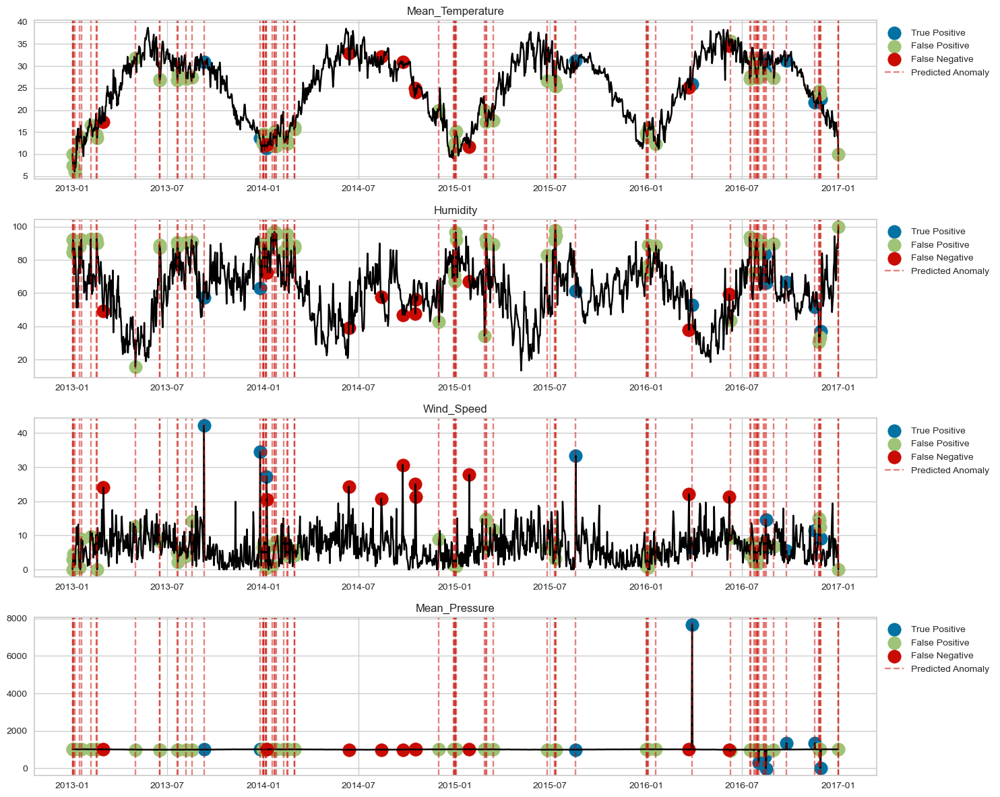

In [89]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_PCA_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [90]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_PCA_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=600, width=1000, title_text=f'Anomaly Detection with PCA - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

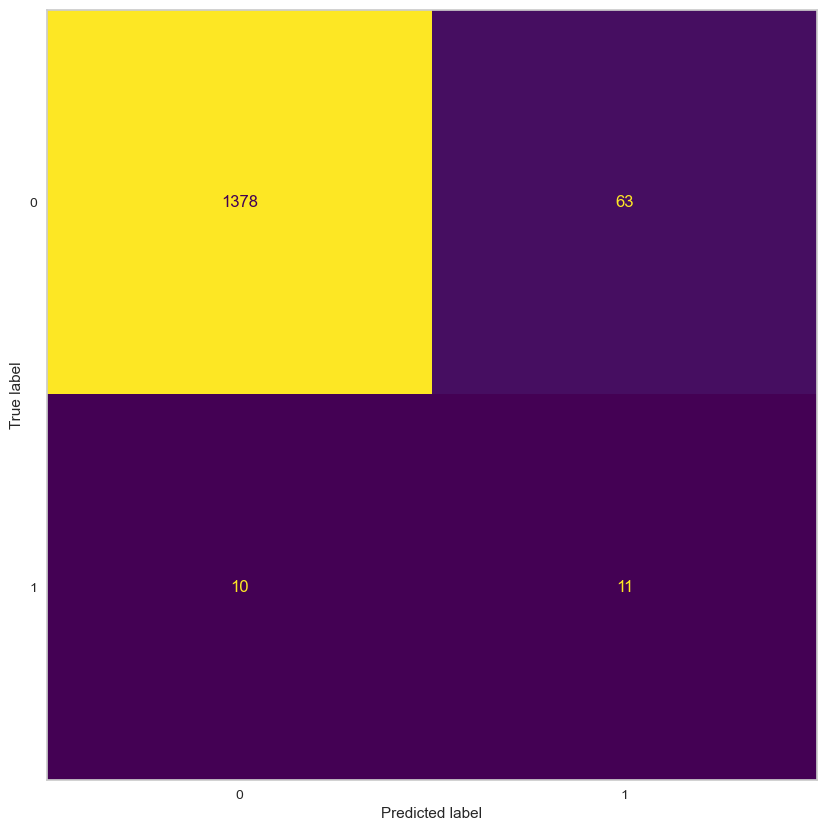

In [91]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_PCA[0], colorbar=False)
plt.grid(False)

In [92]:
scores = print_results('PCA_95', target, anomalies_PCA[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266
KMeans_Cluster_2,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_5,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_1,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
GaussianMixture_4,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101
PCA_95,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101


In [93]:
pca_pipeline = Pipeline([
    ('scaling', StandardScaler()),
    ('pca', PCA(n_components=2))
])

start_time = time.time()
pca_data = pca_pipeline.fit_transform(estimators)
end_time = time.time()
PCA_99=end_time-start_time
time_dict['PCA_99'] = PCA_99

reconstructed_data = pca_pipeline.inverse_transform(pca_data)

reconstruction_error = np.mean((estimators - reconstructed_data)**2, axis=1)

threshold = np.percentile(reconstruction_error, 99)

anomalies_indices = np.where(reconstruction_error > threshold)[0]

anomalies_PCA = pd.DataFrame(data = np.where(reconstruction_error > threshold, 1, 0), index=weather_data.index)

anomalies_PCA_idx = anomalies_PCA[anomalies_PCA[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_PCA_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_PCA_idx:
        FN.append(str(i))

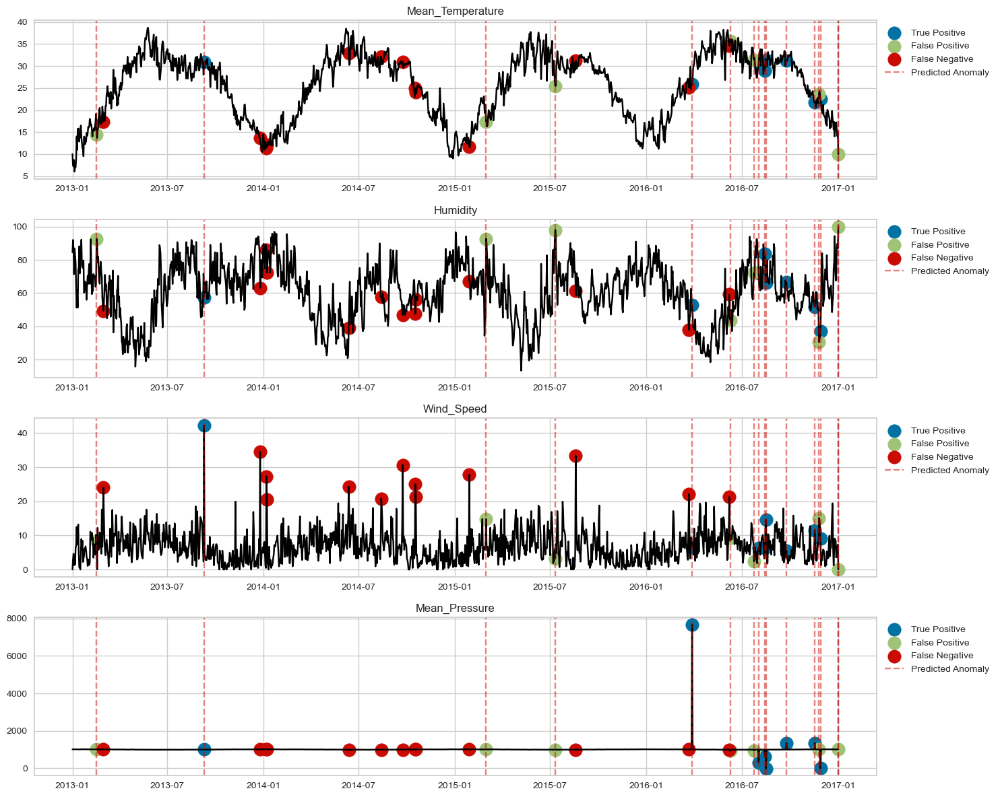

In [94]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_PCA_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [95]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_PCA_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=500, width=1000, title_text=f'Anomaly Detection with PCA - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

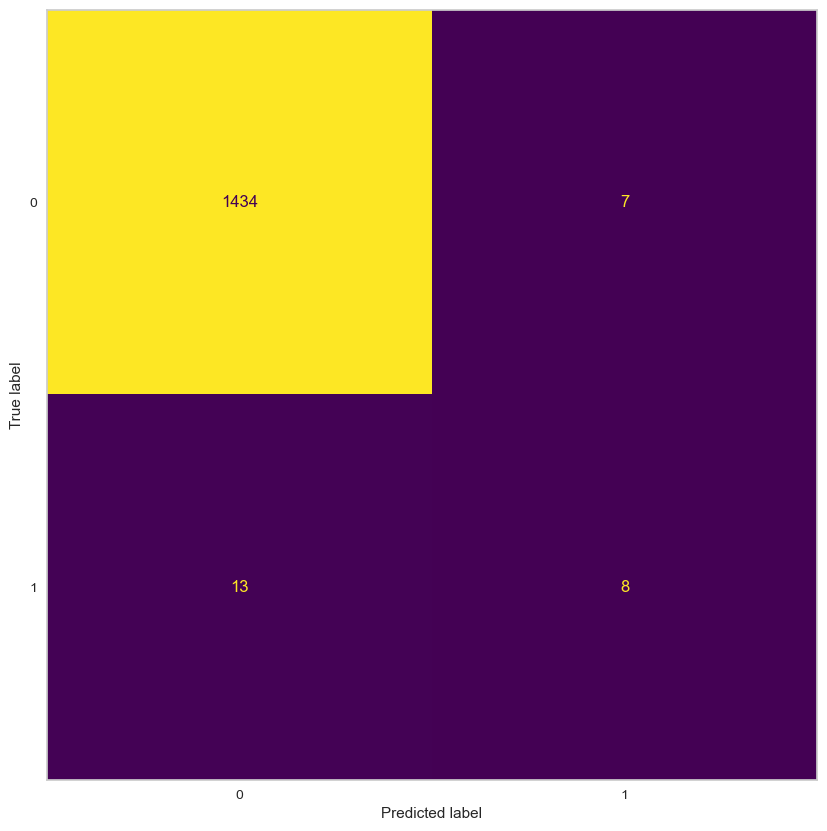

In [96]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_PCA[0], colorbar=False)
plt.grid(False)

In [97]:
scores = print_results('PCA_99', target, anomalies_PCA[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266
KMeans_Cluster_2,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_5,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_1,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
GaussianMixture_4,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101
PCA_95,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101


## Anomaly Detection Using Autoencoder

In [98]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input

In [99]:
input_dim = weather_data_scaled.shape[1]

input_layer = Input(shape=(input_dim,))
encoder = Dense(32, activation='relu')(input_layer)
encoder = Dense(16, activation='relu')(encoder)

decoder = Dense(32, activation='relu')(encoder)
decoder = Dense(input_dim, activation='linear')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

# Compile and train the autoencoder
autoencoder.compile(optimizer='adam', loss='mse')

start_time = time.time()
autoencoder.fit(weather_data_scaled, weather_data_scaled, epochs=100, batch_size=32, shuffle=True, validation_split=0.1, verbose=0)
end_time = time.time()
autoencoder95_time=end_time-start_time
time_dict['autoencoder95_time'] = autoencoder95_time

# Obtain the reconstruction error
reconstructed_data = autoencoder.predict(weather_data_scaled)
reconstruction_error = np.mean(np.power(weather_data_scaled - reconstructed_data, 2), axis=1)

# Set a threshold for considering a data point as an anomaly
threshold = np.percentile(reconstruction_error, 95)  # You can adjust the threshold based on your desired sensitivity

# Get the indices of the anomalies
anomalies_indices = np.where(reconstruction_error > threshold)[0]

anomalies_Autoencoder = pd.DataFrame(data = np.where(reconstruction_error > threshold, 1, 0), index=weather_data.index)

anomalies_Autoencoder_idx = anomalies_Autoencoder[anomalies_PCA[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_Autoencoder_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_Autoencoder_idx:
        FN.append(str(i))

46/46 [==============================] - 0s 933us/step


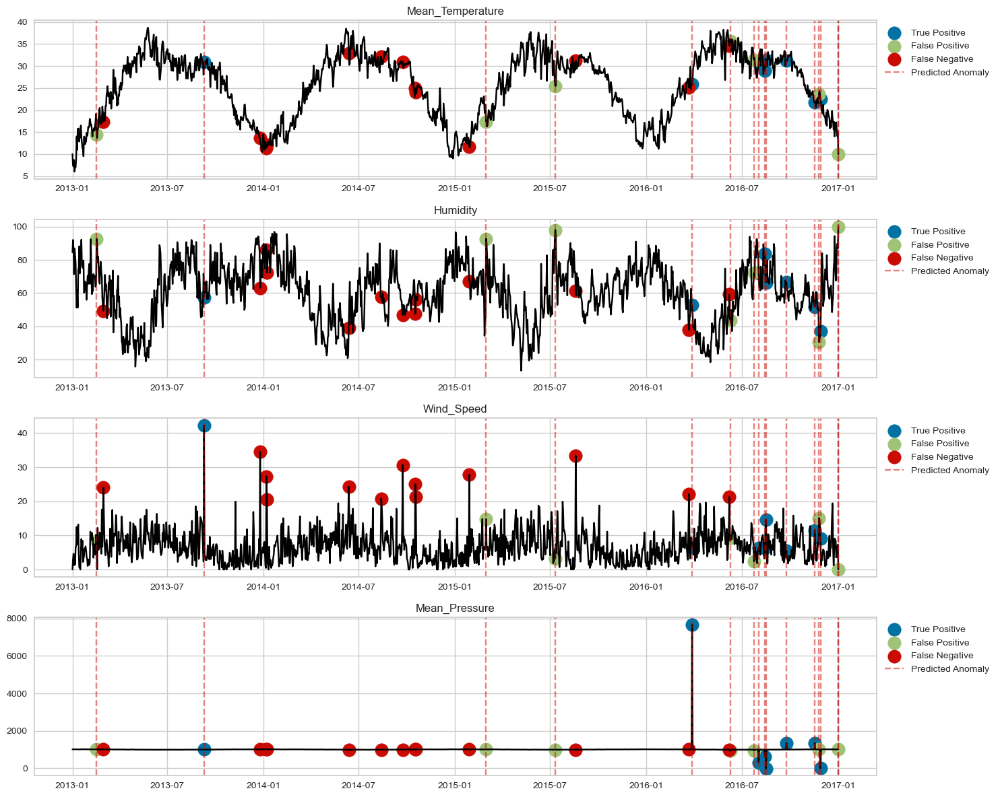

In [100]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_Autoencoder_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [101]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_Autoencoder_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=500, width=1000, title_text=f'Anomaly Detection with Autoencoder - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

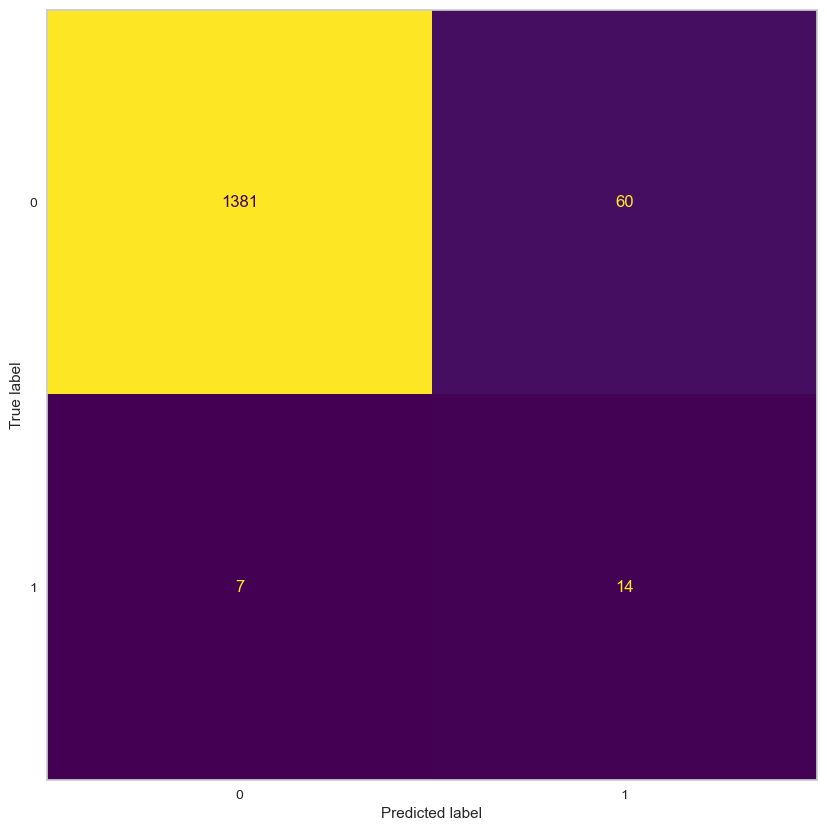

In [102]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_Autoencoder[0], colorbar=False)
plt.grid(False)

In [103]:
scores = print_results('Autoencoder_95', target, anomalies_Autoencoder[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266
KMeans_Cluster_2,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_5,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_1,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
GaussianMixture_4,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101
PCA_95,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101


In [104]:
threshold = np.percentile(reconstruction_error, 99)  # You can adjust the threshold based on your desired sensitivity

# Get the indices of the anomalies
anomalies_indices = np.where(reconstruction_error > threshold)[0]

anomalies_Autoencoder = pd.DataFrame(data = np.where(reconstruction_error > threshold, 1, 0), index=weather_data.index)

anomalies_Autoencoder_idx = anomalies_Autoencoder[anomalies_PCA[0] == 1].index

TP = []
FP = []
FN = []

for i in anomalies_Autoencoder_idx:
    if i in idx:
        TP.append(str(i))
    else:
        FP.append(str(i))
        
for i in idx:
    if i not in anomalies_Autoencoder_idx:
        FN.append(str(i))

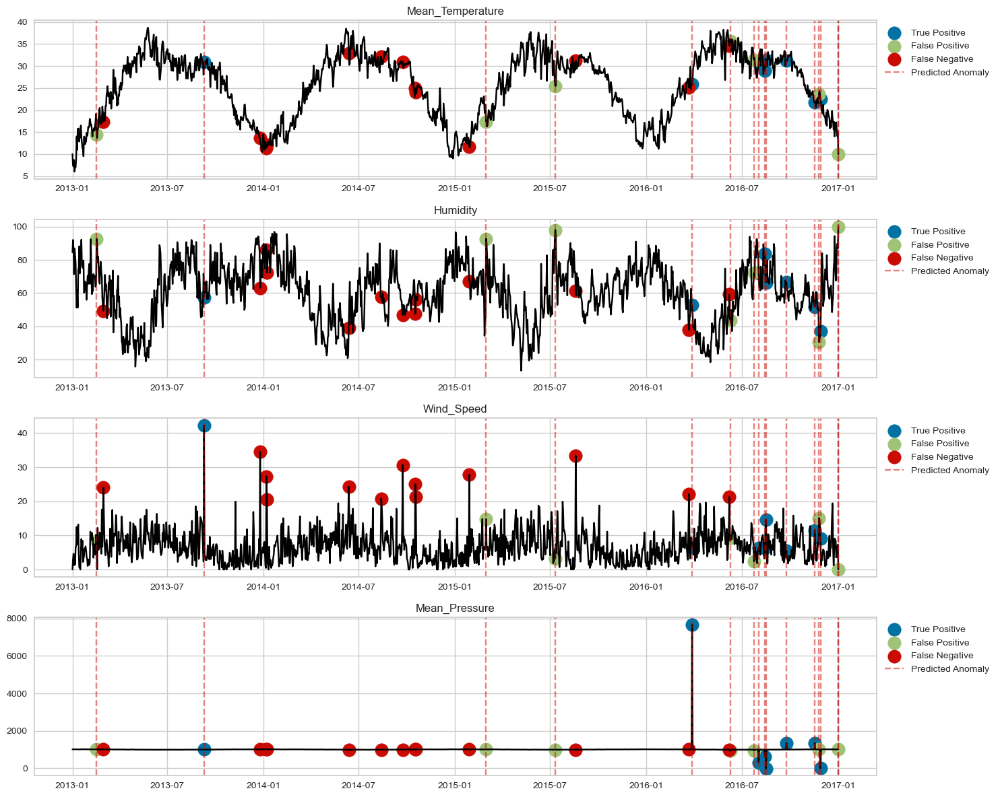

In [105]:
fig, axs = plt.subplots(len(features), 1, figsize=(15, 12))

for i, feature in enumerate(features):
    axs[i].plot(weather_data[feature], c = 'black')
    axs[i].set_title(feature)
    for a,x in enumerate([TP, FP, FN]):
        x = weather_data.loc[x,feature].index
        y = weather_data.loc[x,feature].values
        axs[i].scatter(x, y, label = metrics[a], s = 200)
    for j in anomalies_Autoencoder_idx:
        axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5)
    axs[i].axvline(x=j, color='r', linestyle='--', alpha=0.5, label= 'Predicted Anomaly')
    axs[i].legend(loc='upper left', bbox_to_anchor=(1, 1))
    
plt.tight_layout()
plt.show()

In [106]:
for feature in features:
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=estimators.index, y=estimators[feature], mode='lines', name=feature, line=dict(color='black')))

    for a, x in enumerate([TP, FP, FN]):
        x_idx = estimators.loc[x, feature].index
        y_values = estimators.loc[x, feature].values
        fig.add_trace(go.Scatter(x=x_idx, y=y_values, mode='markers', marker=dict(size=10), name=metrics[a]))

    for j in anomalies_Autoencoder_idx:
        fig.add_shape(type='line', x0=j, x1=j, y0=estimators[feature].min(), y1=estimators[feature].max(), yref='y', xref='x', line=dict(color='red', width=1, dash='dash'))

    fig.update_layout(height=500, width=1000, title_text=f'Anomaly Detection with Autoencoder - {feature}', showlegend=True, legend=dict(orientation='h', yanchor='bottom', y=-0.2, xanchor='right', x=1))
    fig.show()

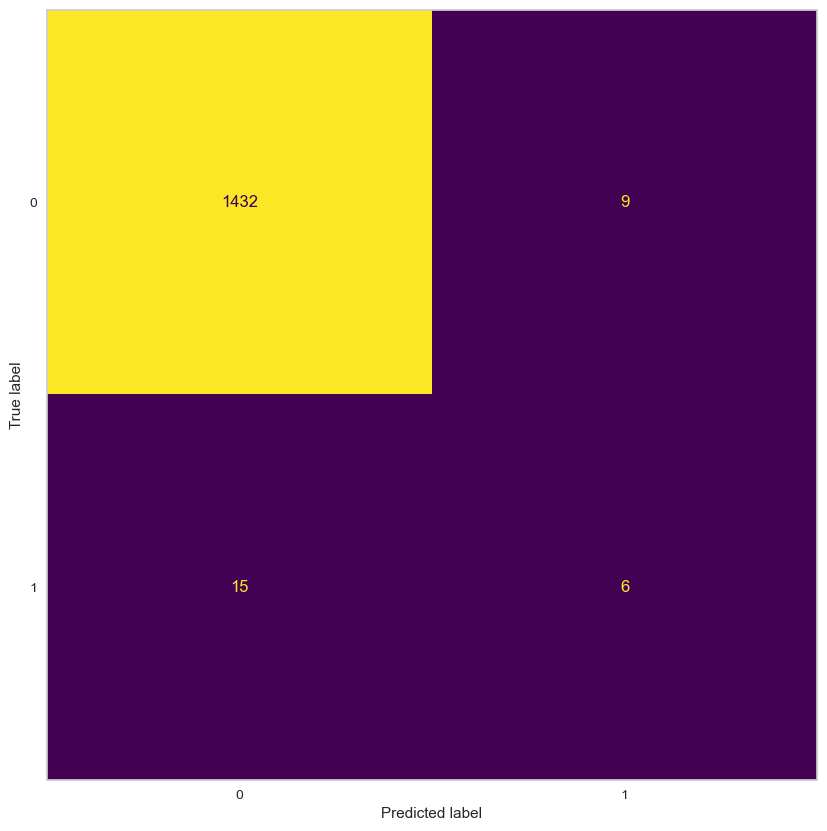

In [107]:
ConfusionMatrixDisplay.from_predictions(target, anomalies_Autoencoder[0], colorbar=False)
plt.grid(False)

In [108]:
scores = print_results('Autoencoder_99', target, anomalies_Autoencoder[0])
dftmp = pd.DataFrame([scores], columns=score_names)
dfAcc = pd.concat([dfAcc, dftmp], ignore_index=True)
dfAcc[['TP','FP', 'TN', 'FN']] = dfAcc[['TP','FP', 'TN', 'FN']].astype(int)
dfAcc.style.hide(axis='index')

method,accuracy,TP,FP,TN,FN,precision,recall,roc_auc,pr_auc,f1,f2
6-Sigma,0.987688,3,0,1441,18,1.000000,0.142857,0.571429,0.577585,0.250000,0.172414
IsolationForest_0.05,0.952804,13,61,1380,8,0.175676,0.619048,0.788358,0.400098,0.273684,0.411392
IsolationForest_0.01,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
KMeans_Cluster_5,0.959644,18,56,1385,3,0.243243,0.857143,0.909140,0.551219,0.378947,0.569620
KMeans_Cluster_10,0.961012,19,55,1386,2,0.256757,0.904762,0.933297,0.581443,0.400000,0.601266
KMeans_Cluster_2,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_5,0.956908,16,58,1383,5,0.216216,0.761905,0.860827,0.490770,0.336842,0.506329
GaussianMixture_1,0.980848,4,11,1430,17,0.266667,0.190476,0.591421,0.234385,0.222222,0.202020
GaussianMixture_4,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101
PCA_95,0.950068,11,63,1378,10,0.148649,0.523810,0.740045,0.339649,0.231579,0.348101


                                                        ML Algorithms Comparison                                                        
 


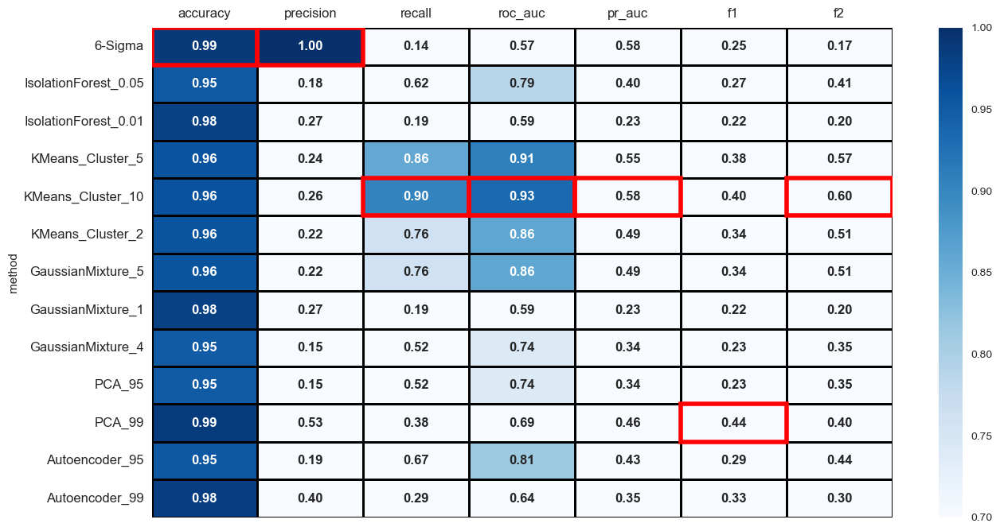

In [109]:
from matplotlib.patches import Rectangle
import seaborn as sns

print('\033[1mML Algorithms Comparison'.center(140))
print(" ")
dfhm = dfAcc[["method","accuracy","precision","recall","roc_auc","pr_auc","f1","f2"]]
dfhm.index = dfhm.method
dfhm.drop("method",axis=1,inplace=True)

plt.figure(figsize=[15,8])
plt.tick_params(axis='both', which='major', labelsize=12, labelbottom = False, bottom=False, top = False, labeltop=True)
chart = sns.heatmap(dfhm, linecolor = "black",
                    yticklabels=['6-Sigma',
                                 'IsolationForest_0.05',
                                 'IsolationForest_0.01',
                                 'KMeans_Cluster_5',
                                 'KMeans_Cluster_10',
                                 'KMeans_Cluster_2',
                                 'GaussianMixture_5',
                                 'GaussianMixture_1',
                                 'GaussianMixture_4',
                                 'PCA_95',
                                 'PCA_99',
                                 'Autoencoder_95',
                                 'Autoencoder_99'],
                    annot=True, annot_kws={"weight": "bold"},vmin=0.7, vmax=1, cmap='Blues',square=False, 
                    fmt='.2f',linewidths=1)
chart.set_yticklabels(chart.get_yticklabels(), rotation = 0, fontsize = 12)

column_max = dfhm.idxmax(axis=0)

for col, variable in enumerate(dfhm.columns):
    position = dfhm.index.get_loc(column_max[variable])
    chart.add_patch(Rectangle((col, position),1,1, fill=False, edgecolor='red', lw=4))
plt.show()

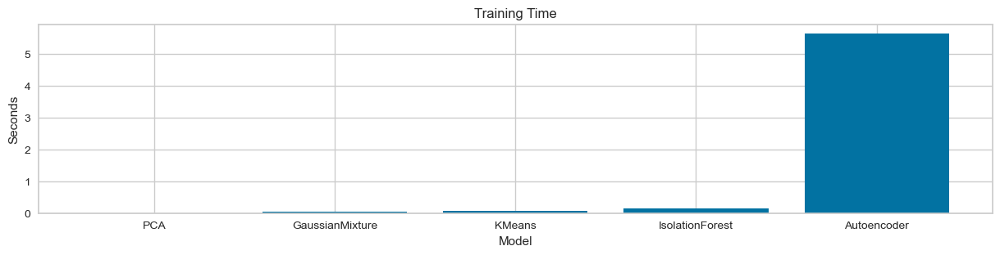

In [110]:
names = ['IsolationForest', 'KMeans', 'GaussianMixture', 'PCA', 'Autoencoder']
values = [0.15065693855285645, 0.05701756477355957, 0.054944515228271484, 0.004987478256225586, 5.641324043273926]

names_sorted, values_sorted = zip(*sorted(zip(names, values), key=lambda x: x[1]))


f = plt.figure(figsize=(15,3),num=10)
plt.bar(names_sorted,values_sorted)
plt.xlabel("Model")
plt.ylabel("Seconds")
plt.title("Training Time")
plt.show()